In [ ]:
import sys
sys.path.append('../..')

from tqdm import tqdm
import numpy as np
import matplotlib.pyplot as plt
plt.style.use('ggplot')
# import pandas as pd
from sklearn.preprocessing import StandardScaler
# from sklearn.decomposition import PCA
from skimage import feature
from itertools import chain
from sklearn.model_selection import train_test_split
import importlib
import utils
importlib.reload(utils)
from utils import get_patches, view_sample_images
import pca_iteration
importlib.reload(pca_iteration)
from pca_iteration import run_pca_iteration

## Preparación de los datos

### Rostros

In [2]:
# Obtener rostros (positive patches)
faces = get_patches(zip_path='../../../content/Faces.zip', patches_path = '../../../content/faces_patches')

# Shape, dtype, min, max
print(f'{ faces.shape = }, {faces.dtype=}, {faces.min()=}, {faces.max()=}')

Loading images: 100%|██████████| 12833/12833 [00:01<00:00, 10524.12it/s]

 faces.shape = (12833, 64, 64), faces.dtype=dtype('uint8'), faces.min()=np.uint8(0), faces.max()=np.uint8(255)


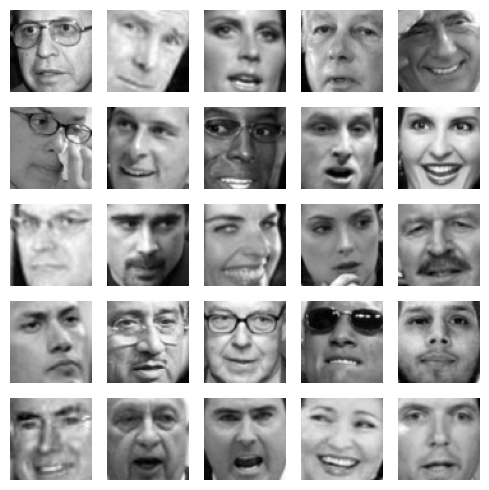

In [3]:
# Visualizamos una muestra
view_sample_images(faces, 25, figsize=(5, 5))

### Fondos

In [4]:
# Obtener fondos (negative patches)
backgrounds = get_patches(zip_path='../../../content/Backgrounds_original.zip', patches_path = '../../../content/background_patches_original')

# Shape, dtype, min, max
print(f'{ backgrounds.shape = }, {backgrounds.dtype=}, {backgrounds.min()=}, {backgrounds.max()=}')

Loading images: 100%|██████████| 12800/12800 [00:01<00:00, 10826.00it/s]

 backgrounds.shape = (12800, 64, 64), backgrounds.dtype=dtype('uint8'), backgrounds.min()=np.uint8(0), backgrounds.max()=np.uint8(255)


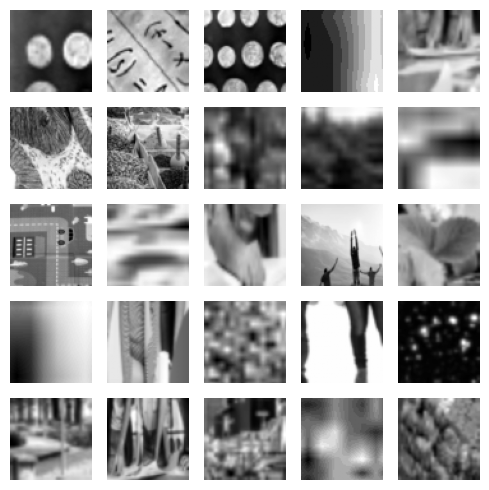

In [5]:
# Visualizamos una muestra
view_sample_images(backgrounds, 25, figsize=(5, 5))

## PCA

In [6]:
X = np.array([feature.hog(im) for im in tqdm(chain(faces, backgrounds), desc='Construyendo X')])
y = np.zeros(len(X), dtype=int)
y[:len(faces)] = 1

Construyendo X: 25633it [00:19, 1282.62it/s]


In [7]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

print(f'{ X_train.shape = }, {X_train.dtype=}, {X_train.min()=}, {X_train.max()=}')

 X_train.shape = (20506, 2916), X_train.dtype=dtype('float64'), X_train.min()=np.float64(0.0), X_train.max()=np.float64(0.9999999987499999)


In [8]:
scaler = StandardScaler()

X_train_std = scaler.fit_transform(X_train)


Running experiment with n_components = 20
Suffix: x1_v1_20
Explained variance ratio: 0.3620
Tarea 2


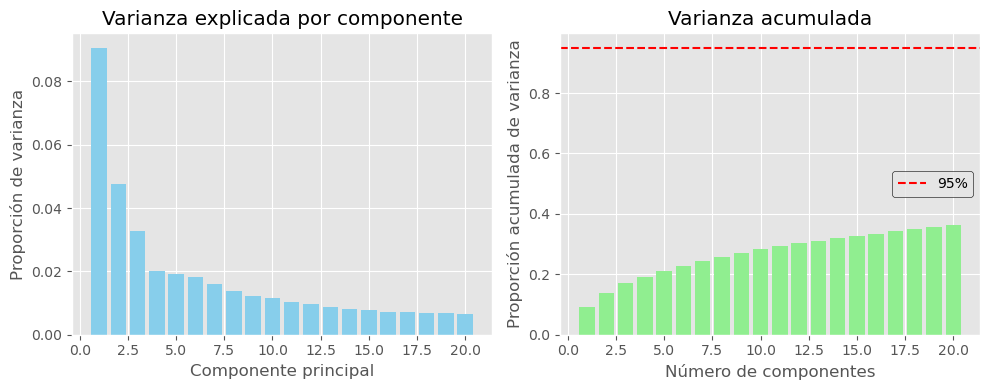

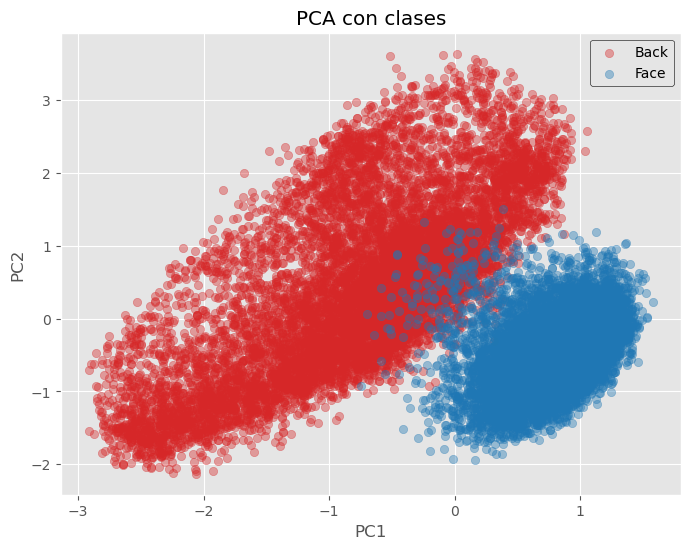

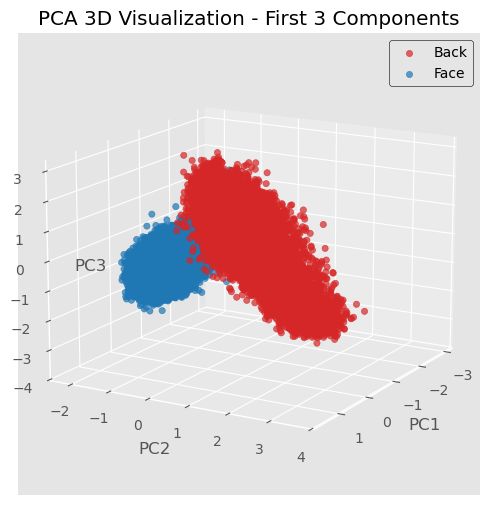

<Figure size 1200x1000 with 0 Axes>

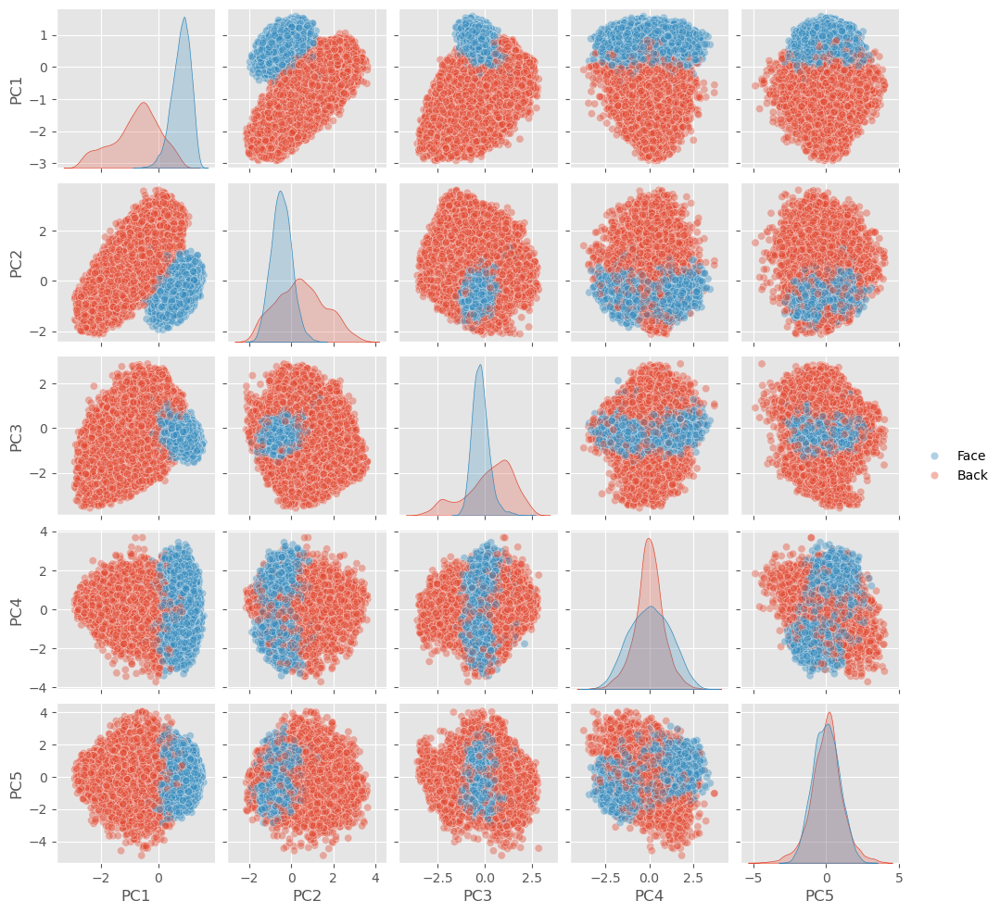


Training Classification Report:
              precision    recall  f1-score   support

           0       0.97      1.00      0.98     10273
           1       1.00      0.96      0.98     10233

    accuracy                           0.98     20506
   macro avg       0.98      0.98      0.98     20506
weighted avg       0.98      0.98      0.98     20506


Test Classification Report:
              precision    recall  f1-score   support

           0       0.97      1.00      0.98      2527
           1       1.00      0.97      0.98      2600

    accuracy                           0.98      5127
   macro avg       0.98      0.98      0.98      5127
weighted avg       0.98      0.98      0.98      5127


Experiment x1_v1_20 completed!
Explained Variance: 0.3620
Train F1: 0.9813
Test F1: 0.9832

Running experiment with n_components = 50
Suffix: x1_v1_50
Explained variance ratio: 0.4983
Tarea 2


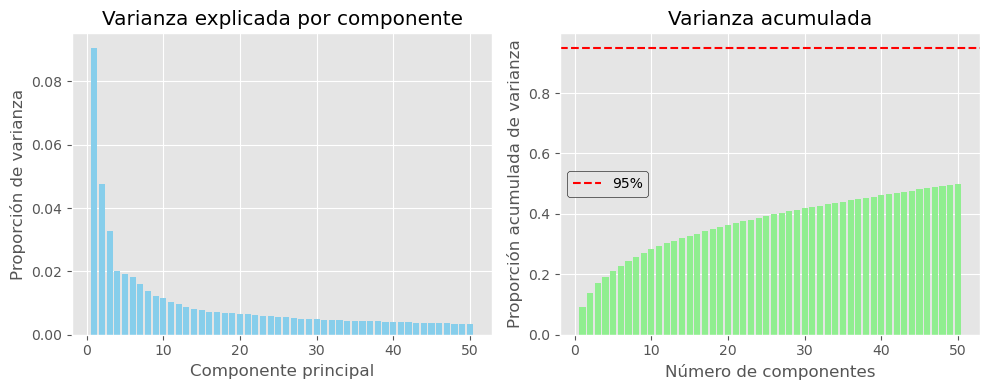

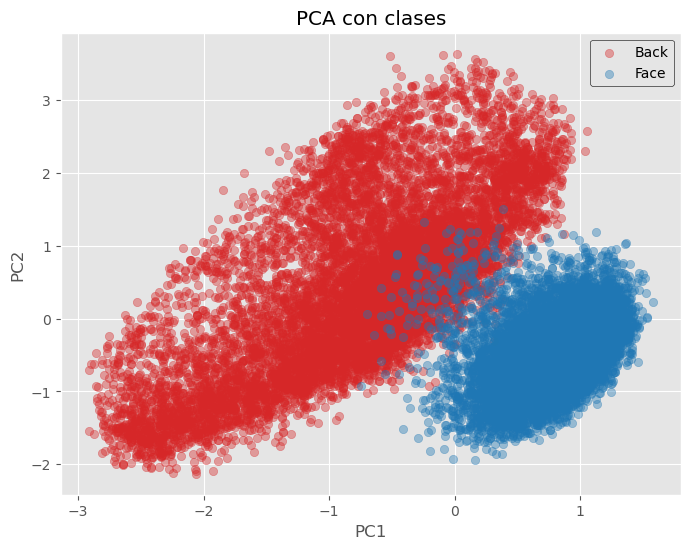

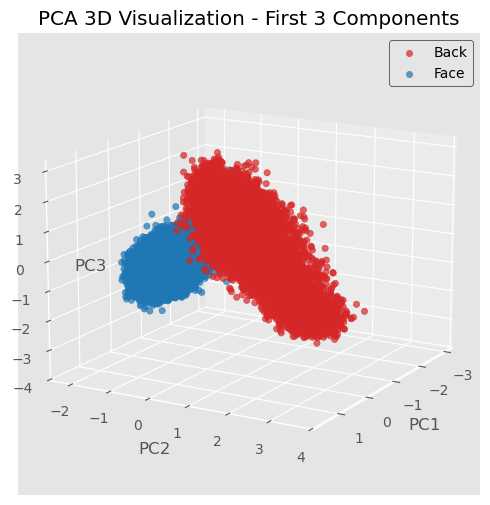

<Figure size 1200x1000 with 0 Axes>

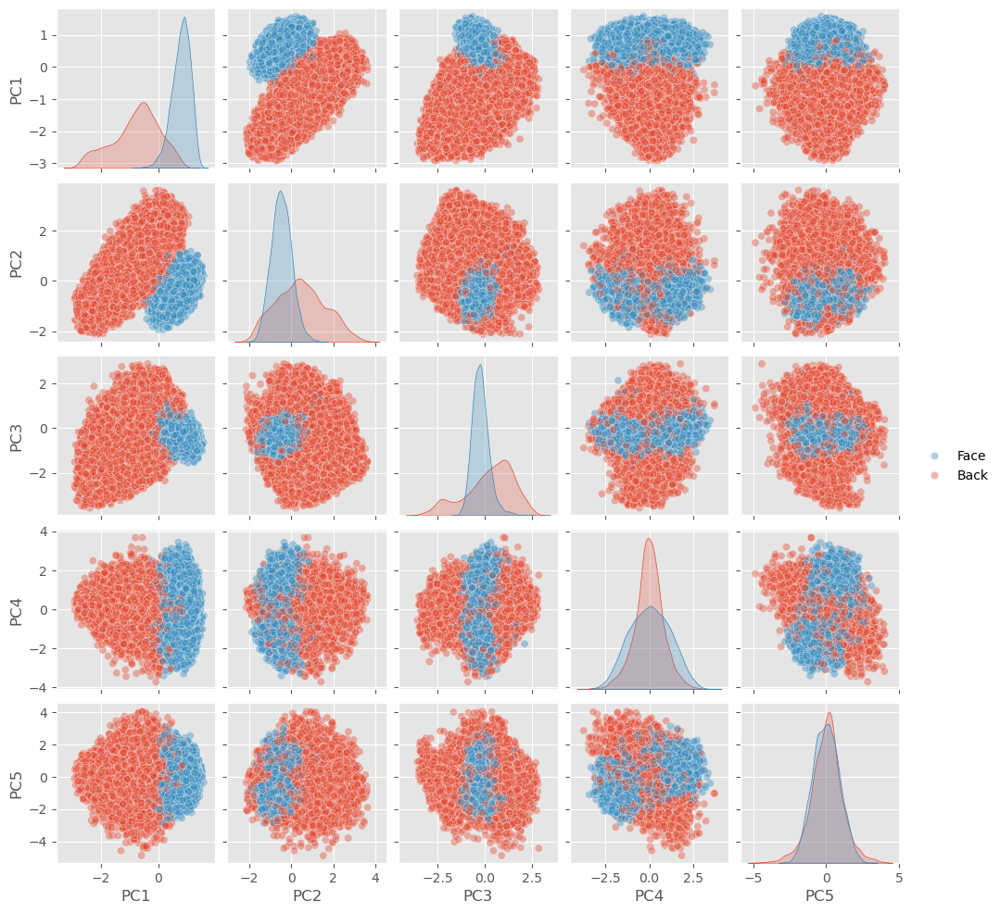


Training Classification Report:
              precision    recall  f1-score   support

           0       0.96      1.00      0.98     10273
           1       1.00      0.96      0.98     10233

    accuracy                           0.98     20506
   macro avg       0.98      0.98      0.98     20506
weighted avg       0.98      0.98      0.98     20506


Test Classification Report:
              precision    recall  f1-score   support

           0       0.96      1.00      0.98      2527
           1       1.00      0.96      0.98      2600

    accuracy                           0.98      5127
   macro avg       0.98      0.98      0.98      5127
weighted avg       0.98      0.98      0.98      5127


Experiment x1_v1_50 completed!
Explained Variance: 0.4983
Train F1: 0.9800
Test F1: 0.9789

Running experiment with n_components = 100
Suffix: x1_v1_100
Explained variance ratio: 0.6284
Tarea 2


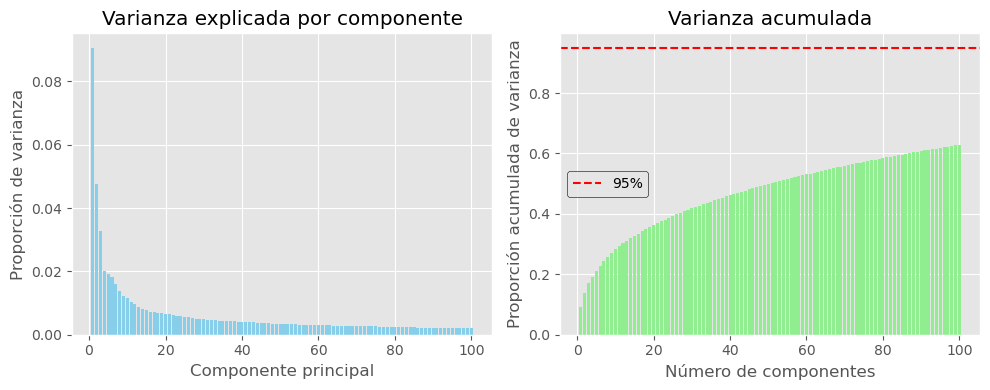

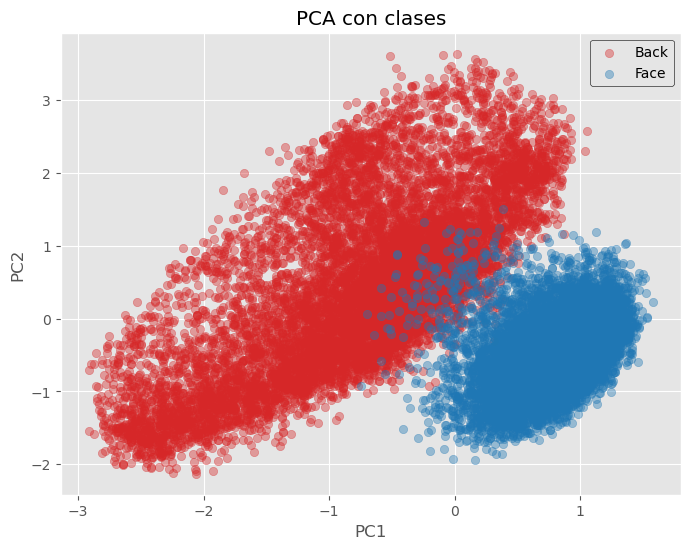

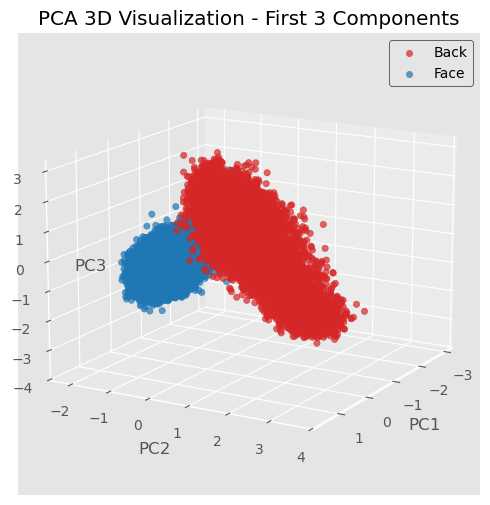

<Figure size 1200x1000 with 0 Axes>

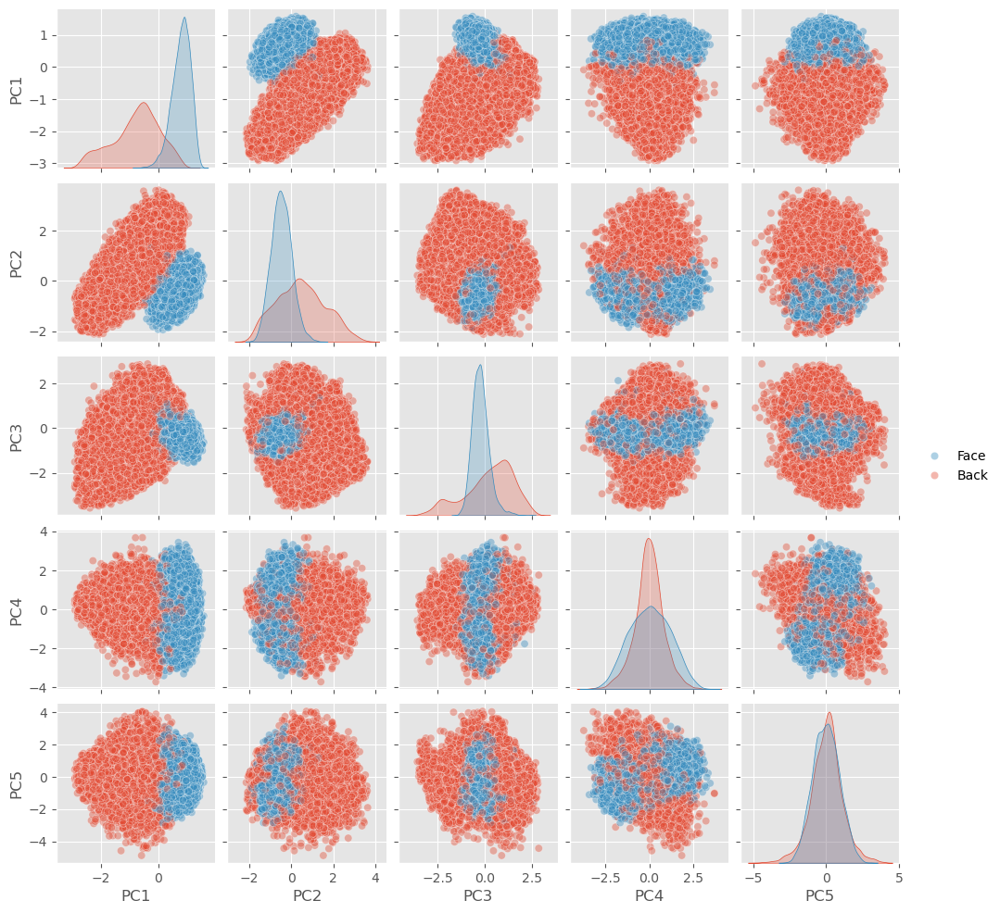


Training Classification Report:
              precision    recall  f1-score   support

           0       0.95      1.00      0.97     10273
           1       1.00      0.95      0.97     10233

    accuracy                           0.97     20506
   macro avg       0.97      0.97      0.97     20506
weighted avg       0.97      0.97      0.97     20506


Test Classification Report:
              precision    recall  f1-score   support

           0       0.96      1.00      0.98      2527
           1       1.00      0.95      0.97      2600

    accuracy                           0.97      5127
   macro avg       0.98      0.98      0.97      5127
weighted avg       0.98      0.97      0.97      5127


Experiment x1_v1_100 completed!
Explained Variance: 0.6284
Train F1: 0.9719
Test F1: 0.9748

Running experiment with n_components = 200
Suffix: x1_v1_200
Explained variance ratio: 0.7780
Tarea 2


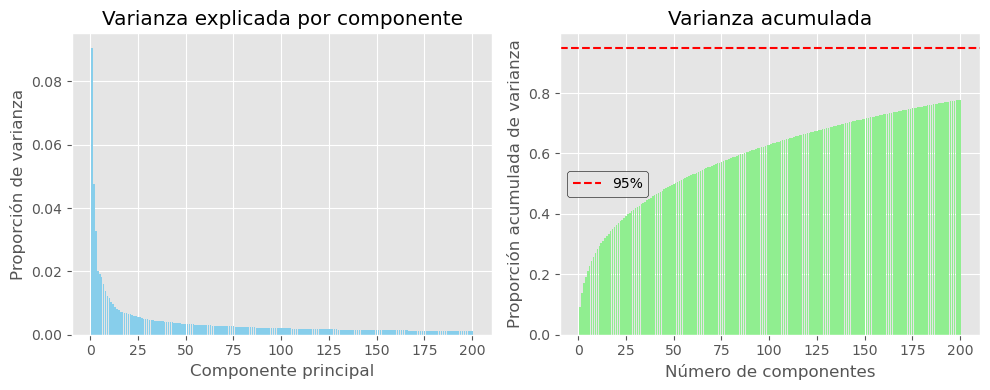

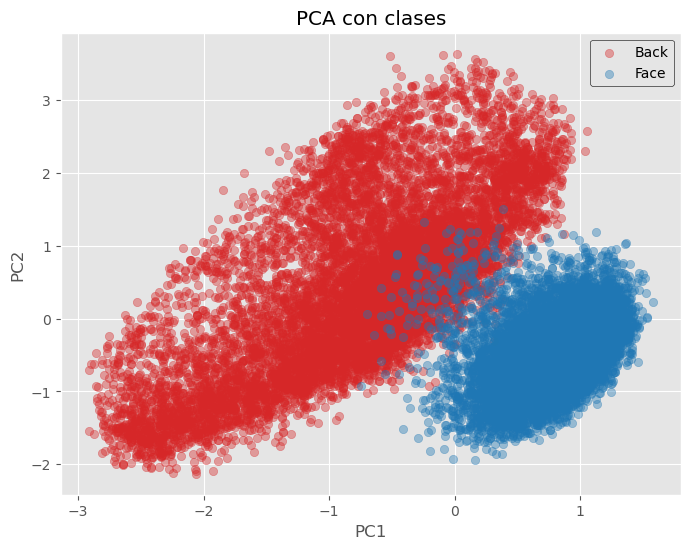

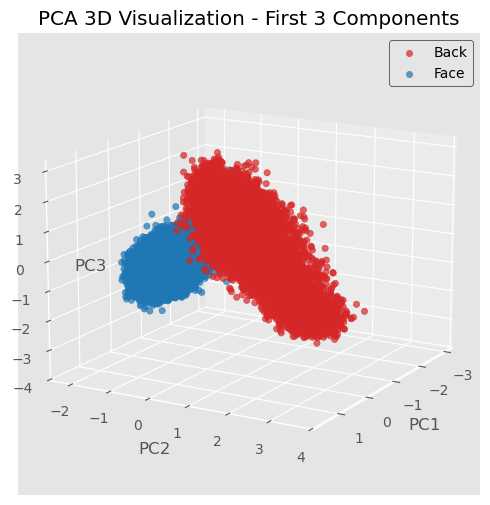

<Figure size 1200x1000 with 0 Axes>

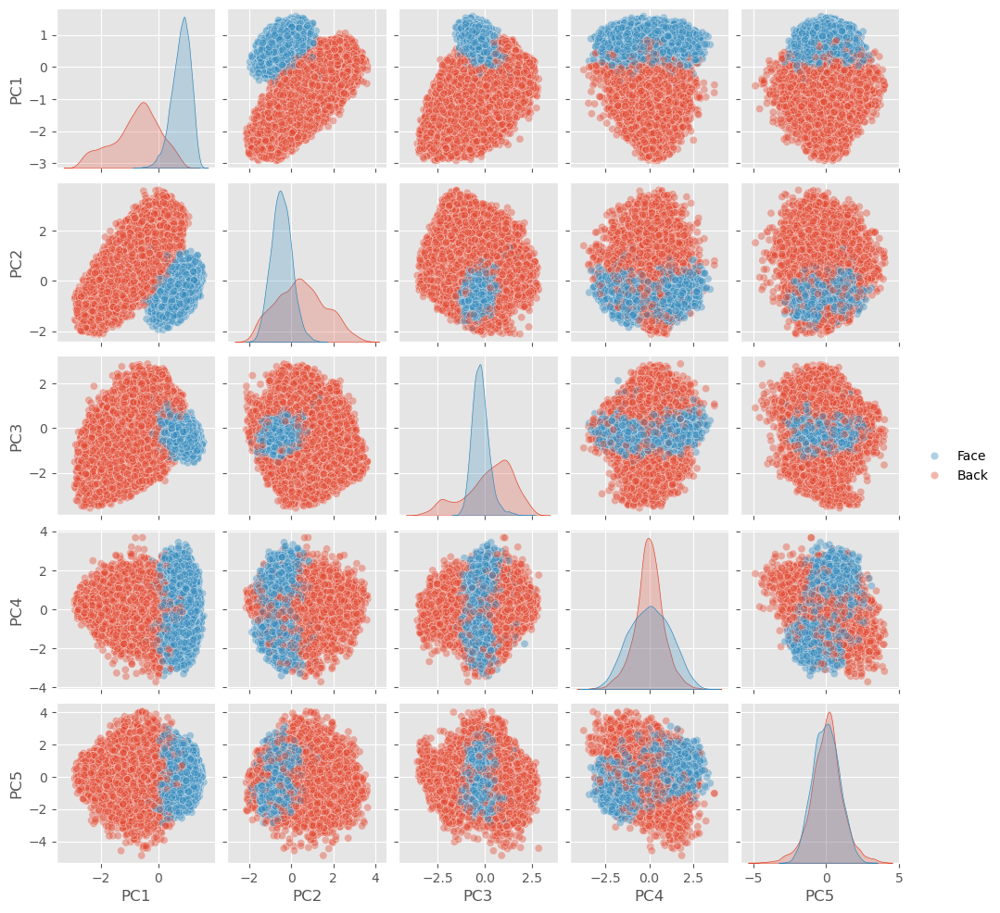


Training Classification Report:
              precision    recall  f1-score   support

           0       0.94      0.99      0.96     10273
           1       0.99      0.94      0.96     10233

    accuracy                           0.96     20506
   macro avg       0.96      0.96      0.96     20506
weighted avg       0.96      0.96      0.96     20506


Test Classification Report:
              precision    recall  f1-score   support

           0       0.95      0.99      0.97      2527
           1       0.99      0.95      0.97      2600

    accuracy                           0.97      5127
   macro avg       0.97      0.97      0.97      5127
weighted avg       0.97      0.97      0.97      5127


Experiment x1_v1_200 completed!
Explained Variance: 0.7780
Train F1: 0.9635
Test F1: 0.9666

Running experiment with n_components = 500
Suffix: x1_v1_500
Explained variance ratio: 0.9653
Tarea 2


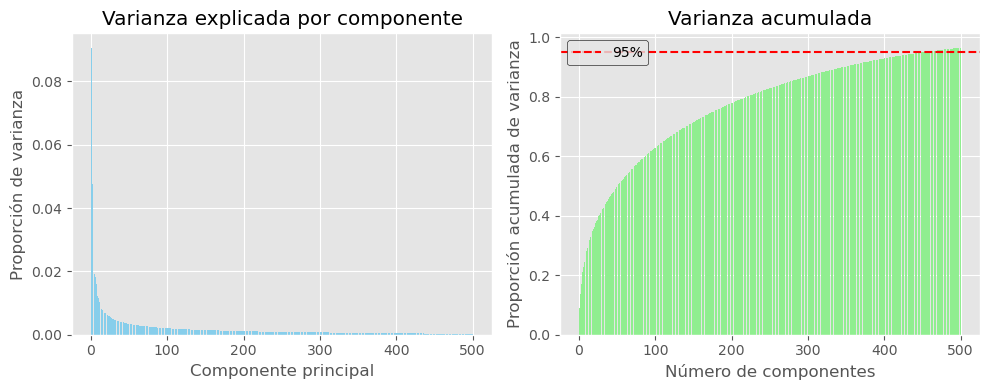

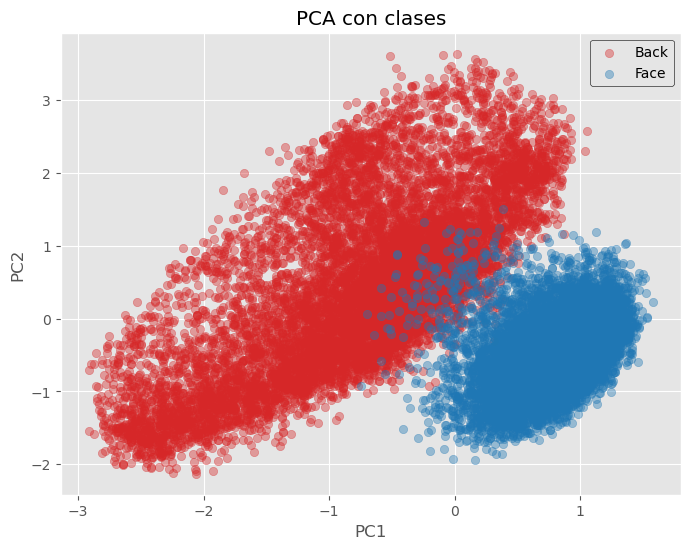

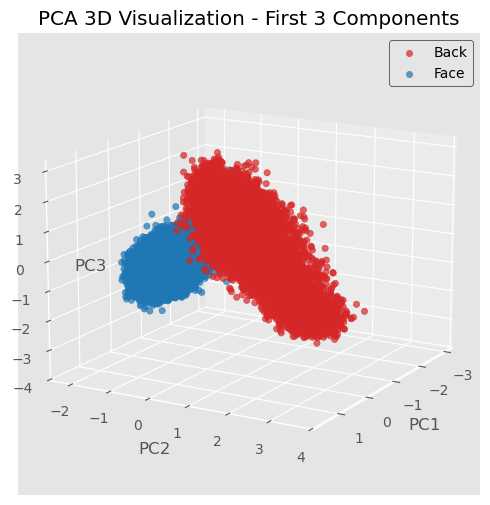

<Figure size 1200x1000 with 0 Axes>

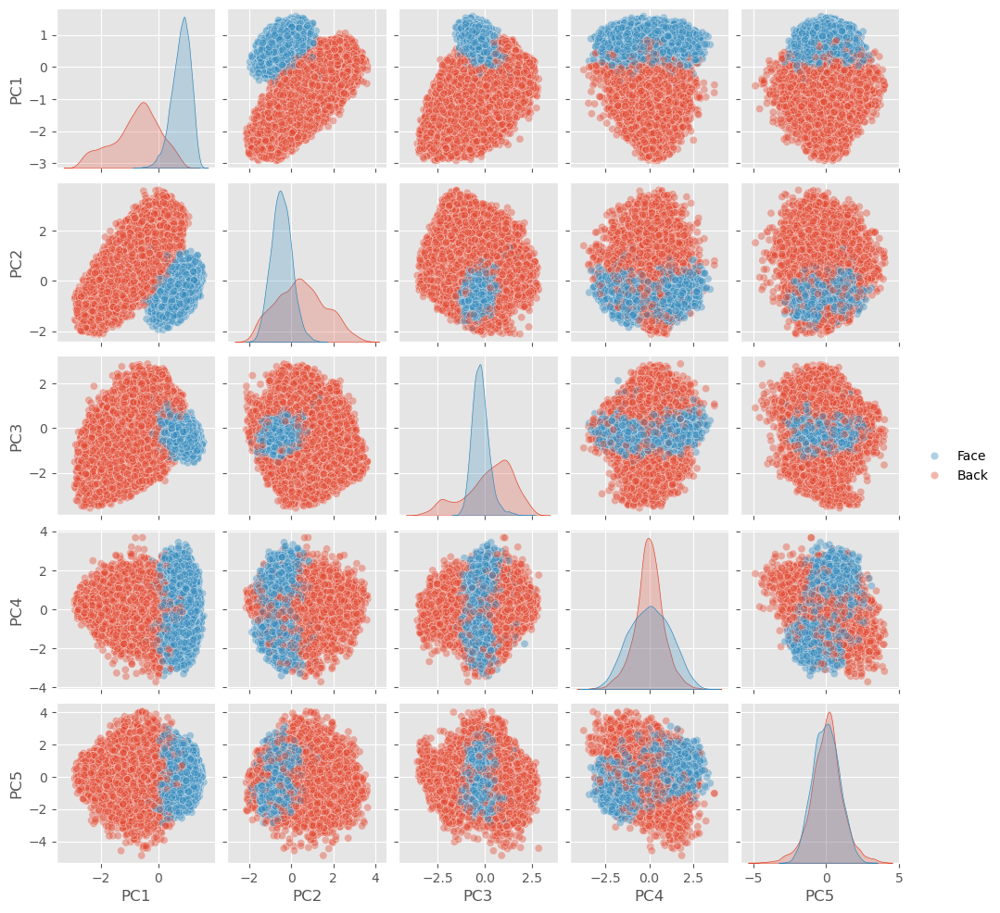


Training Classification Report:
              precision    recall  f1-score   support

           0       0.94      0.97      0.96     10273
           1       0.97      0.94      0.95     10233

    accuracy                           0.95     20506
   macro avg       0.95      0.95      0.95     20506
weighted avg       0.95      0.95      0.95     20506


Test Classification Report:
              precision    recall  f1-score   support

           0       0.93      0.98      0.95      2527
           1       0.97      0.93      0.95      2600

    accuracy                           0.95      5127
   macro avg       0.95      0.95      0.95      5127
weighted avg       0.95      0.95      0.95      5127


Experiment x1_v1_500 completed!
Explained Variance: 0.9653
Train F1: 0.9545
Test F1: 0.9497


In [ ]:
# PCA
n_components_list = [20, 50, 100, 200, 500]

results = run_pca_iteration(
    X_train_std=X_train_std,
    y_train=y_train,
    X_test=X_test,
    y_test=y_test,
    scaler=scaler,
    n_components_list=n_components_list,
    ratio='x1',
)

Cambios a HOG

In [11]:
hog_params = {
    'orientations': 9,
    'pixels_per_cell': (8, 8),
    'cells_per_block': (2, 2),
    'block_norm': 'L2-Hys',
    'visualize': False,
    'transform_sqrt': True,
    'feature_vector': True,
}

X = np.array([feature.hog(im, **hog_params) for im in tqdm(chain(faces, backgrounds), desc='Construyendo X')])
y = np.zeros(len(X), dtype=int)
y[:len(faces)] = 1

Construyendo X: 25633it [00:19, 1321.13it/s]


In [12]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

print(f'{ X_train.shape = }, {X_train.dtype=}, {X_train.min()=}, {X_train.max()=}')

 X_train.shape = (20506, 1764), X_train.dtype=dtype('float64'), X_train.min()=np.float64(0.0), X_train.max()=np.float64(0.9999999987499999)


In [13]:
scaler = StandardScaler()

X_train_std = scaler.fit_transform(X_train)


Running experiment with n_components = 20
Suffix: x1_v1_20
Explained variance ratio: 0.3711
Tarea 2


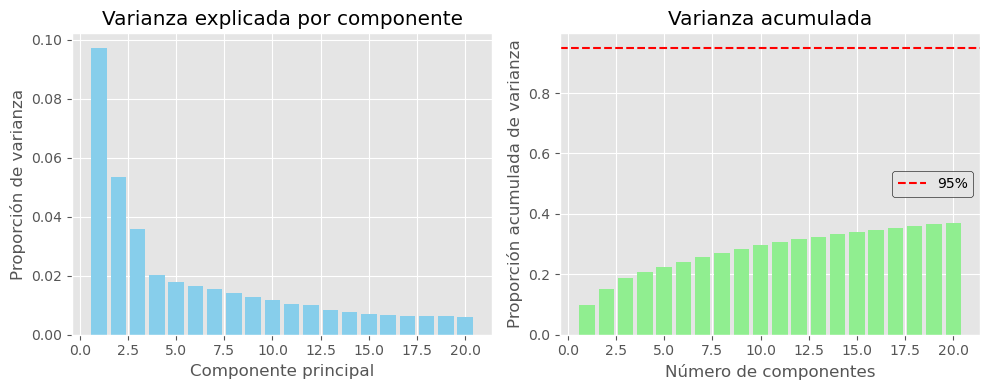

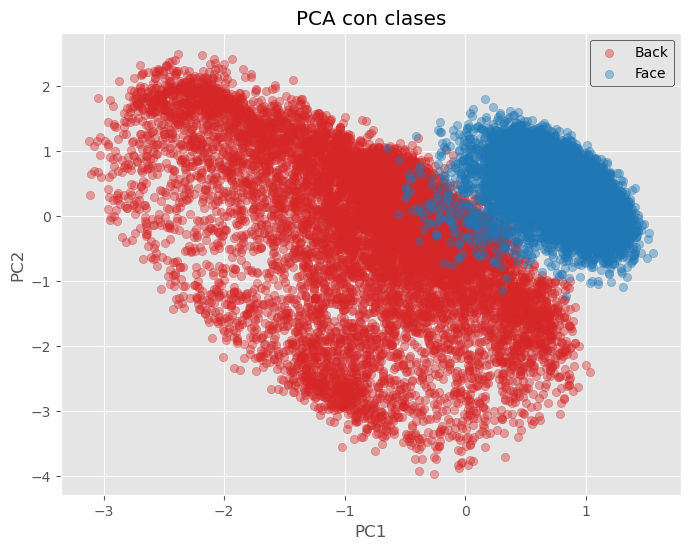

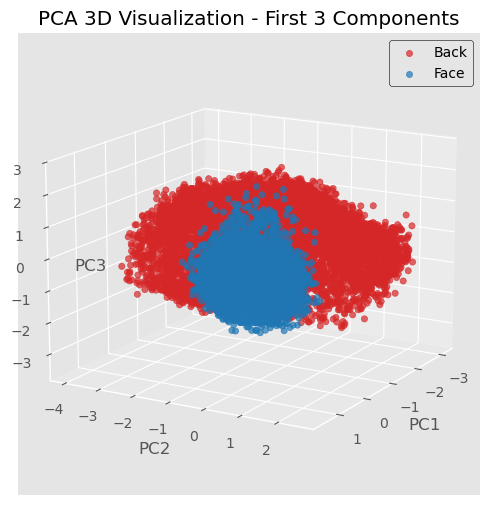

<Figure size 1200x1000 with 0 Axes>

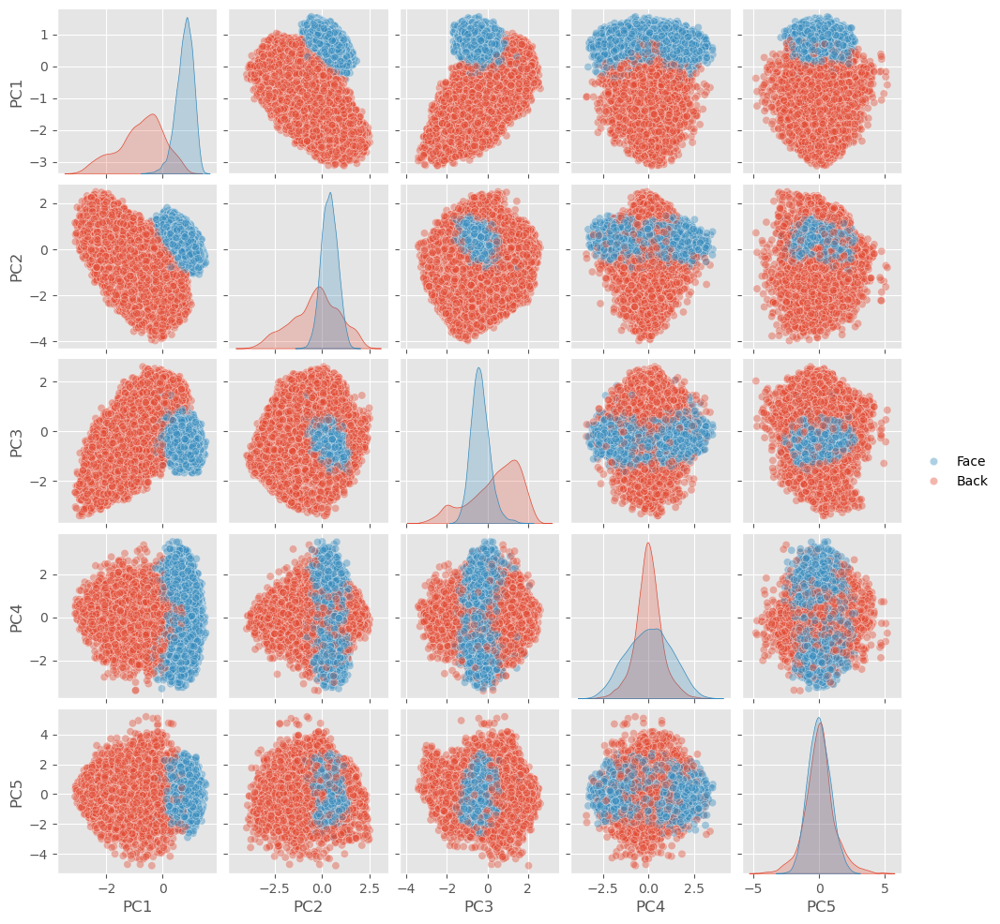


Training Classification Report:
              precision    recall  f1-score   support

           0       0.97      1.00      0.98     10273
           1       1.00      0.97      0.98     10233

    accuracy                           0.98     20506
   macro avg       0.98      0.98      0.98     20506
weighted avg       0.98      0.98      0.98     20506


Test Classification Report:
              precision    recall  f1-score   support

           0       0.97      1.00      0.98      2527
           1       1.00      0.97      0.98      2600

    accuracy                           0.98      5127
   macro avg       0.98      0.98      0.98      5127
weighted avg       0.98      0.98      0.98      5127


Experiment x1_v1_20 completed!
Explained Variance: 0.3711
Train F1: 0.9844
Test F1: 0.9840

Running experiment with n_components = 50
Suffix: x1_v1_50
Explained variance ratio: 0.4954
Tarea 2


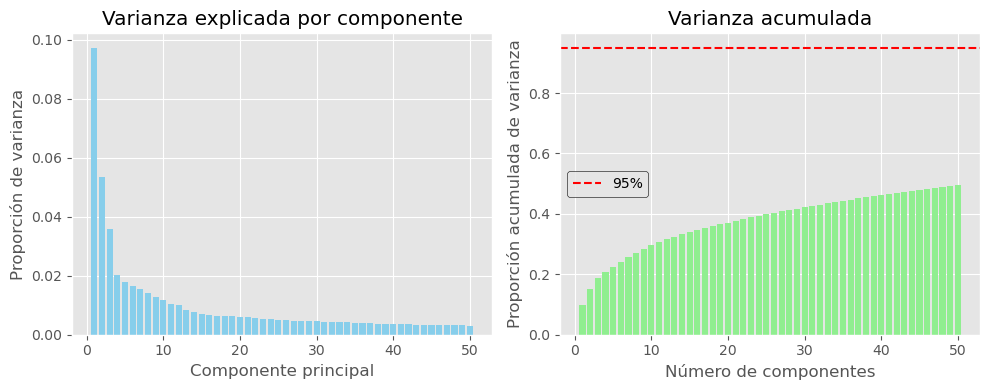

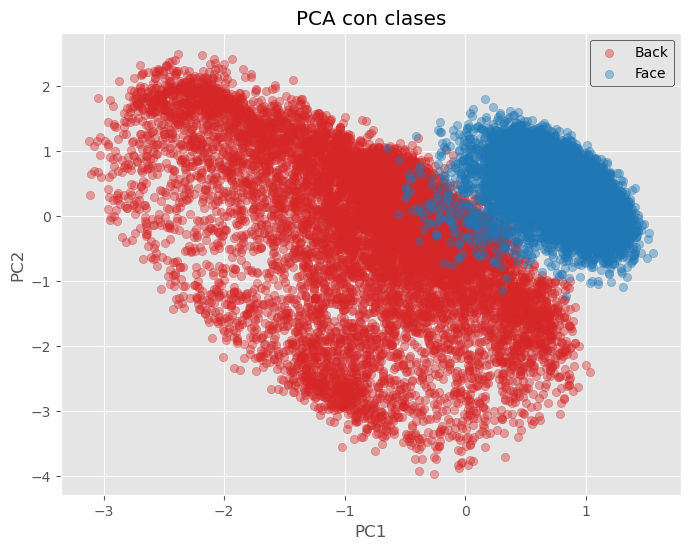

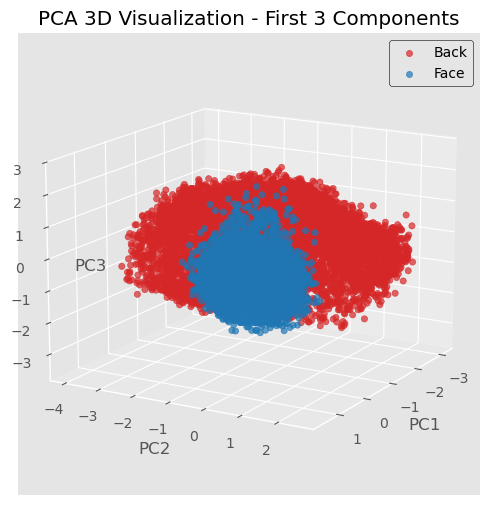

<Figure size 1200x1000 with 0 Axes>

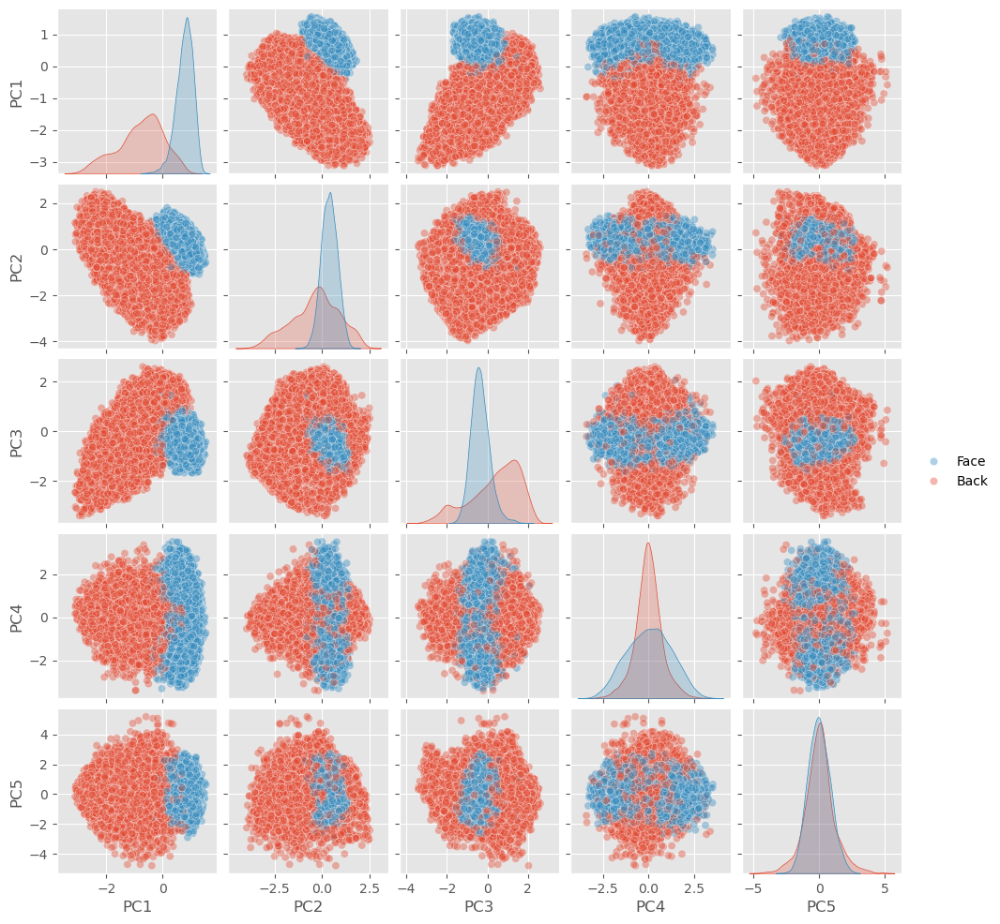


Training Classification Report:
              precision    recall  f1-score   support

           0       0.96      1.00      0.98     10273
           1       1.00      0.96      0.98     10233

    accuracy                           0.98     20506
   macro avg       0.98      0.98      0.98     20506
weighted avg       0.98      0.98      0.98     20506


Test Classification Report:
              precision    recall  f1-score   support

           0       0.97      1.00      0.98      2527
           1       1.00      0.97      0.98      2600

    accuracy                           0.98      5127
   macro avg       0.98      0.98      0.98      5127
weighted avg       0.98      0.98      0.98      5127


Experiment x1_v1_50 completed!
Explained Variance: 0.4954
Train F1: 0.9811
Test F1: 0.9819

Running experiment with n_components = 100
Suffix: x1_v1_100
Explained variance ratio: 0.6166
Tarea 2


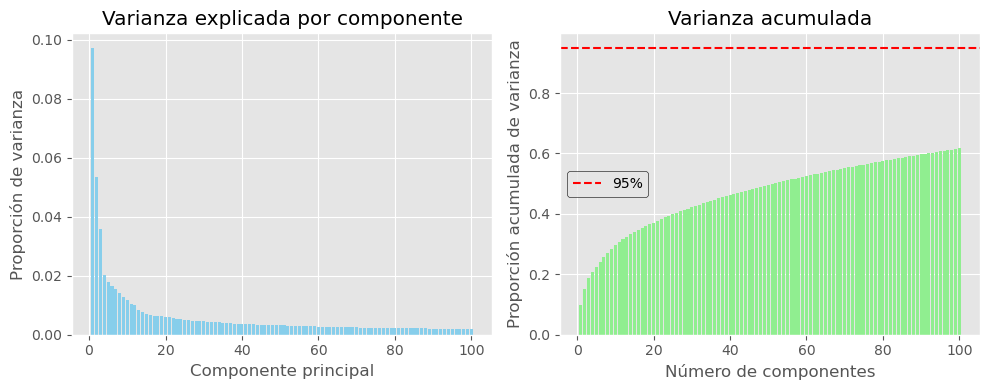

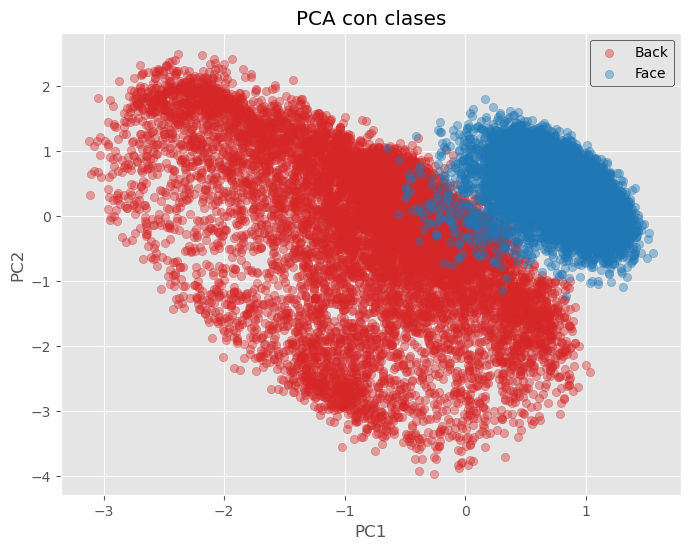

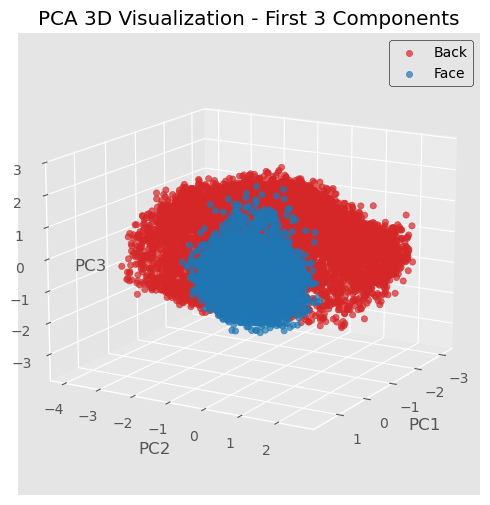

<Figure size 1200x1000 with 0 Axes>

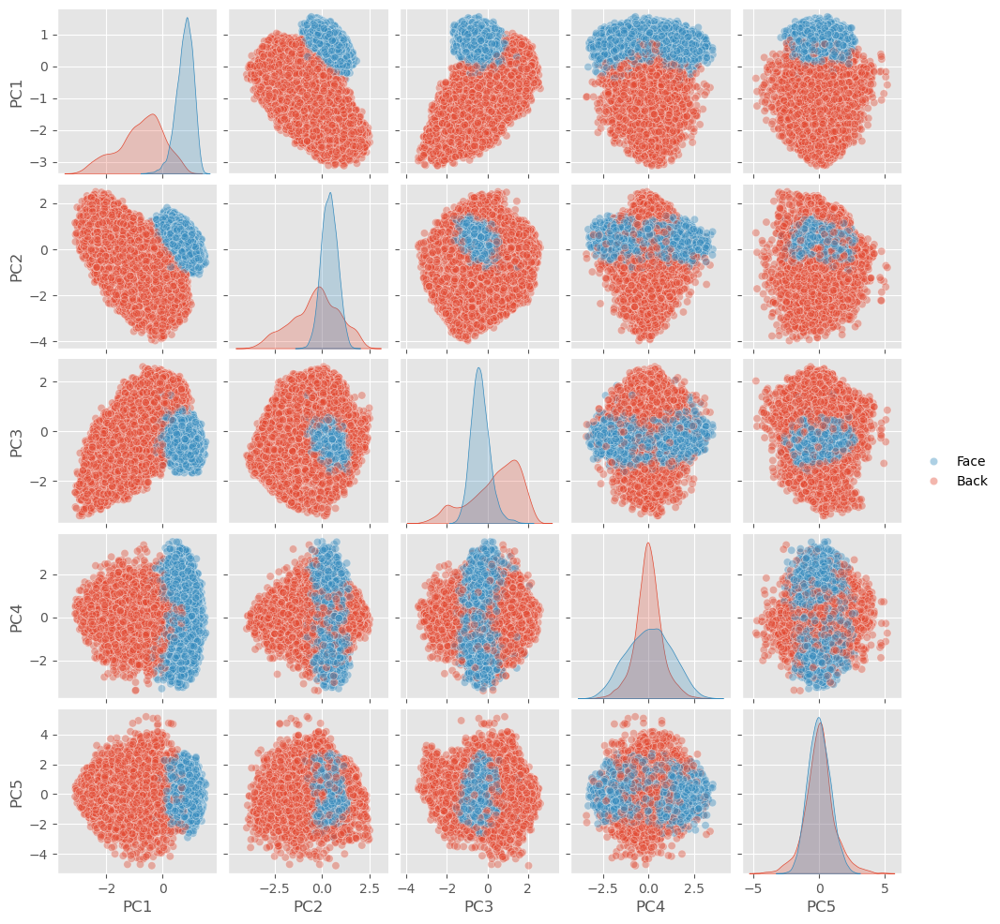


Training Classification Report:
              precision    recall  f1-score   support

           0       0.96      0.99      0.98     10273
           1       0.99      0.96      0.97     10233

    accuracy                           0.97     20506
   macro avg       0.98      0.97      0.97     20506
weighted avg       0.98      0.97      0.97     20506


Test Classification Report:
              precision    recall  f1-score   support

           0       0.96      0.99      0.98      2527
           1       0.99      0.96      0.98      2600

    accuracy                           0.98      5127
   macro avg       0.98      0.98      0.98      5127
weighted avg       0.98      0.98      0.98      5127


Experiment x1_v1_100 completed!
Explained Variance: 0.6166
Train F1: 0.9746
Test F1: 0.9766

Running experiment with n_components = 200
Suffix: x1_v1_200
Explained variance ratio: 0.7580
Tarea 2


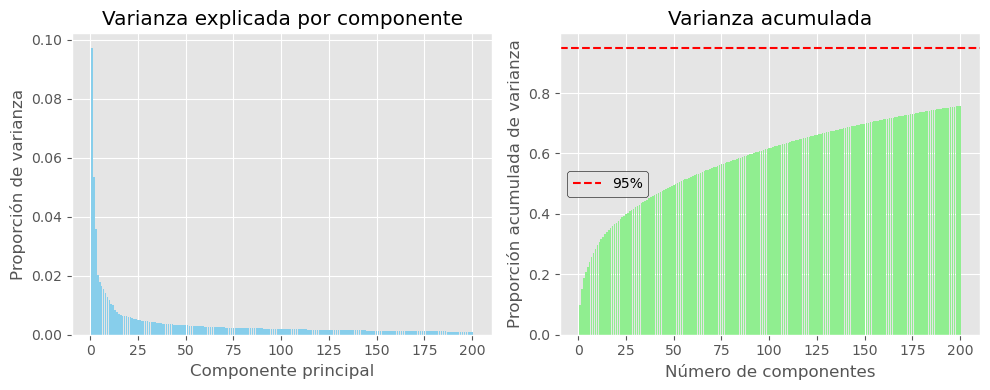

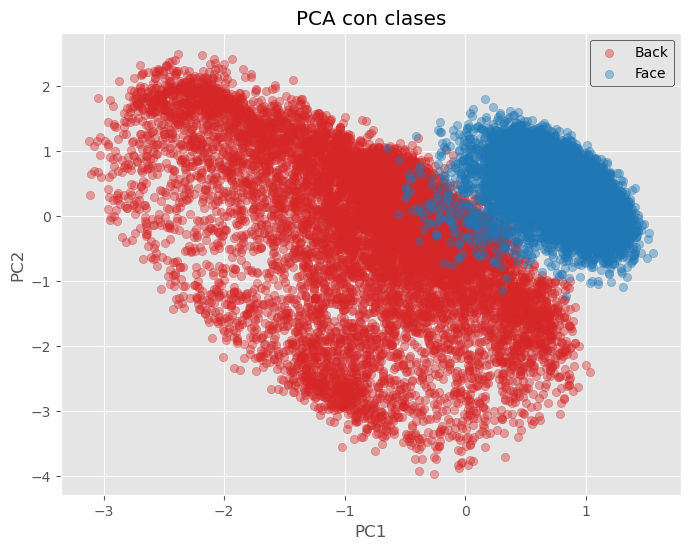

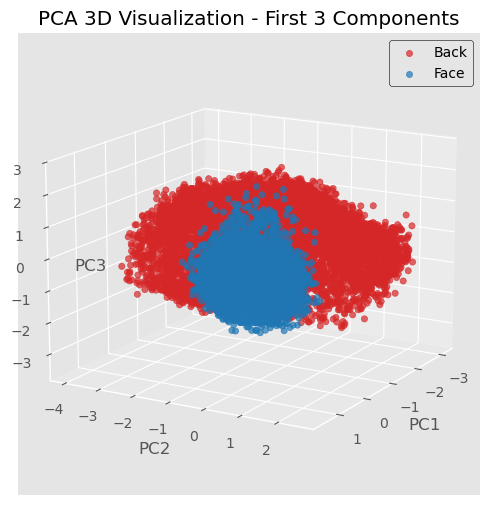

<Figure size 1200x1000 with 0 Axes>

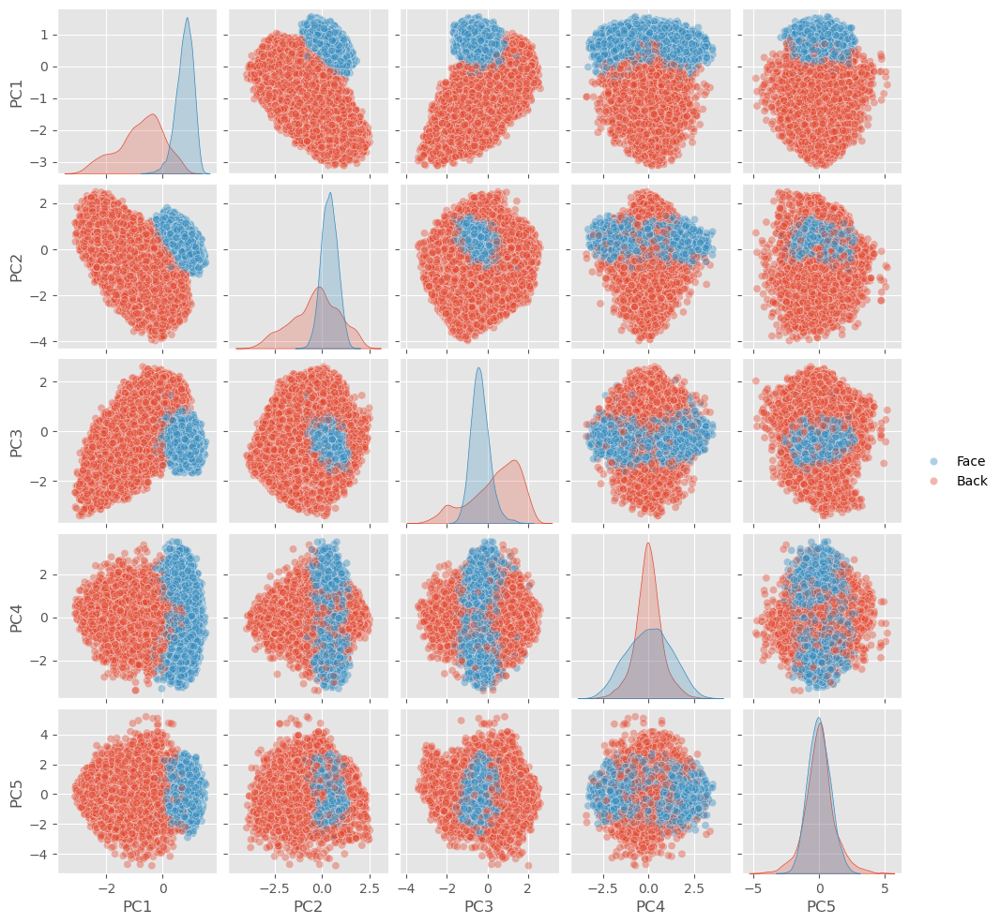


Training Classification Report:
              precision    recall  f1-score   support

           0       0.95      0.97      0.96     10273
           1       0.97      0.95      0.96     10233

    accuracy                           0.96     20506
   macro avg       0.96      0.96      0.96     20506
weighted avg       0.96      0.96      0.96     20506


Test Classification Report:
              precision    recall  f1-score   support

           0       0.95      0.97      0.96      2527
           1       0.97      0.95      0.96      2600

    accuracy                           0.96      5127
   macro avg       0.96      0.96      0.96      5127
weighted avg       0.96      0.96      0.96      5127


Experiment x1_v1_200 completed!
Explained Variance: 0.7580
Train F1: 0.9606
Test F1: 0.9616

Running experiment with n_components = 500
Suffix: x1_v1_500
Explained variance ratio: 0.9548
Tarea 2


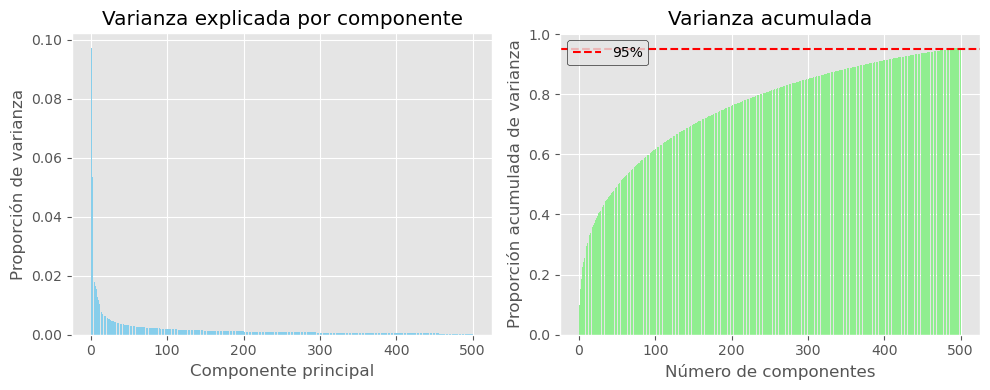

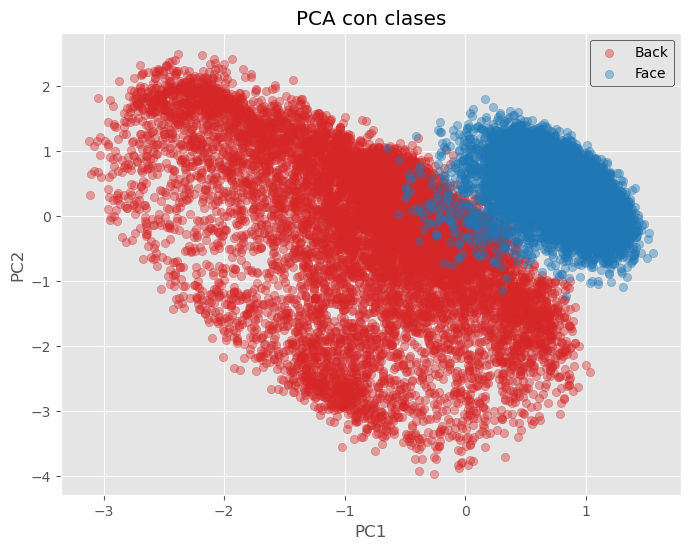

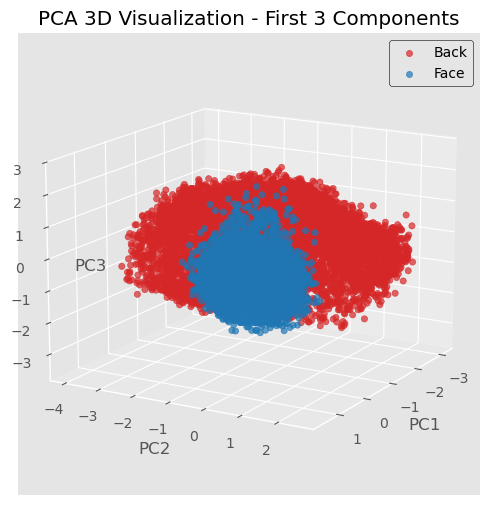

<Figure size 1200x1000 with 0 Axes>

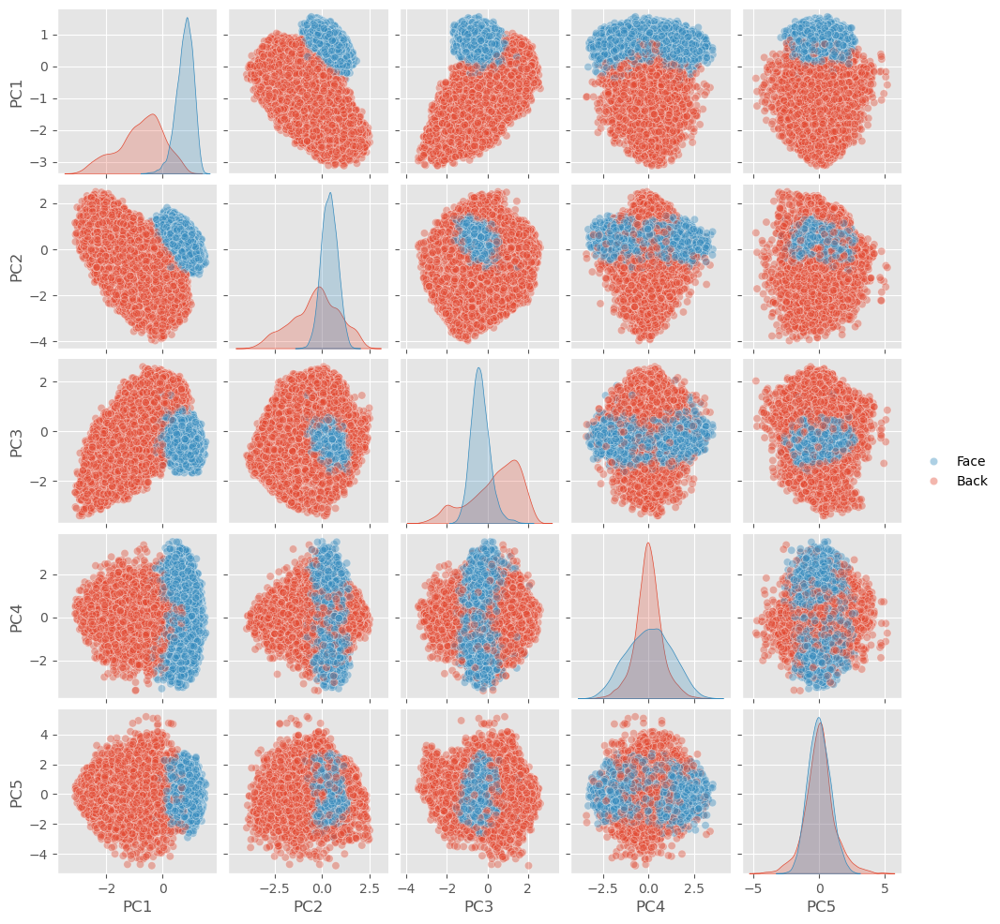


Training Classification Report:
              precision    recall  f1-score   support

           0       0.95      0.94      0.95     10273
           1       0.94      0.95      0.95     10233

    accuracy                           0.95     20506
   macro avg       0.95      0.95      0.95     20506
weighted avg       0.95      0.95      0.95     20506


Test Classification Report:
              precision    recall  f1-score   support

           0       0.95      0.95      0.95      2527
           1       0.95      0.95      0.95      2600

    accuracy                           0.95      5127
   macro avg       0.95      0.95      0.95      5127
weighted avg       0.95      0.95      0.95      5127


Experiment x1_v1_500 completed!
Explained Variance: 0.9548
Train F1: 0.9475
Test F1: 0.9514


In [ ]:
# PCA
n_components_list = [20, 50, 100, 200, 500]

results = run_pca_iteration(
    X_train_std=X_train_std,
    y_train=y_train,
    X_test=X_test,
    y_test=y_test,
    scaler=scaler,
    n_components_list=n_components_list,
    ratio='x1',
    hog_changes=True
)

### Fondos x2

In [15]:
# Obtener fondos (negative patches)
RATIO = "x2_v1"
SUFFIX = f'_{RATIO}'  # Sufijo para los parches de fondo
backgrounds = get_patches(zip_path=f'../../../content/Backgrounds{SUFFIX}.zip', patches_path = f'../../../content/background_patches{SUFFIX}')

# Shape, dtype, min, max
print(f'{ backgrounds.shape = }, {backgrounds.dtype=}, {backgrounds.min()=}, {backgrounds.max()=}')

Loading images: 100%|██████████| 25666/25666 [00:02<00:00, 9501.82it/s] 

 backgrounds.shape = (25666, 64, 64), backgrounds.dtype=dtype('uint8'), backgrounds.min()=np.uint8(0), backgrounds.max()=np.uint8(255)


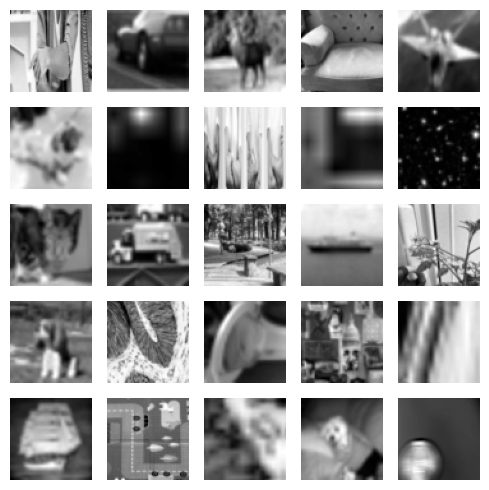

In [16]:
# Visualizamos una muestra
view_sample_images(backgrounds, 25, figsize=(5, 5))

In [17]:
X = np.array([feature.hog(im) for im in tqdm(chain(faces, backgrounds), desc='Construyendo X')])
y = np.zeros(len(X), dtype=int)
y[:len(faces)] = 1

Construyendo X: 38499it [00:27, 1382.33it/s]


In [18]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

print(f'{ X_train.shape = }, {X_train.dtype=}, {X_train.min()=}, {X_train.max()=}')

 X_train.shape = (30799, 2916), X_train.dtype=dtype('float64'), X_train.min()=np.float64(0.0), X_train.max()=np.float64(0.9999999987499999)


In [19]:
scaler = StandardScaler()

X_train_std = scaler.fit_transform(X_train)


Running experiment with n_components = 20
Suffix: x2_v1_20
Explained variance ratio: 0.3294
Tarea 2


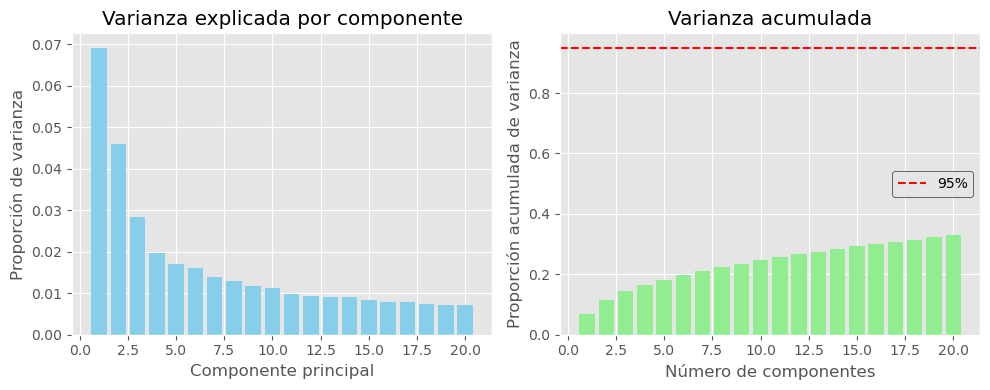

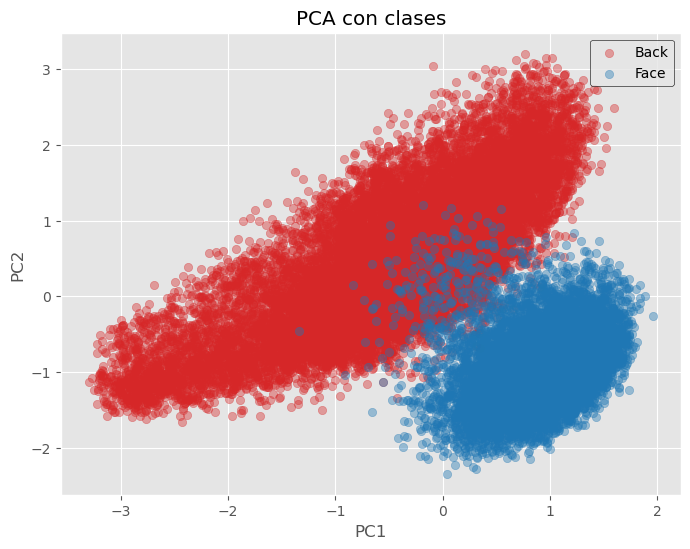

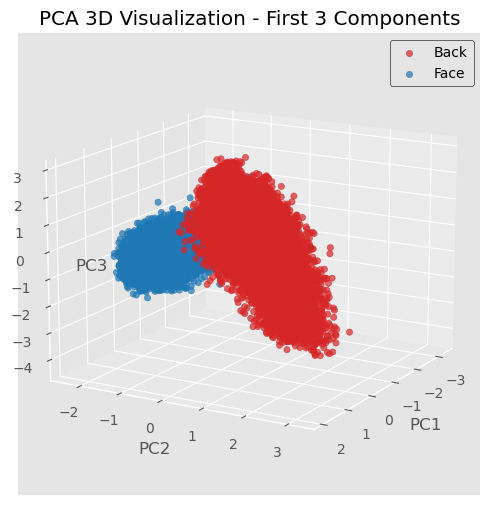

<Figure size 1200x1000 with 0 Axes>

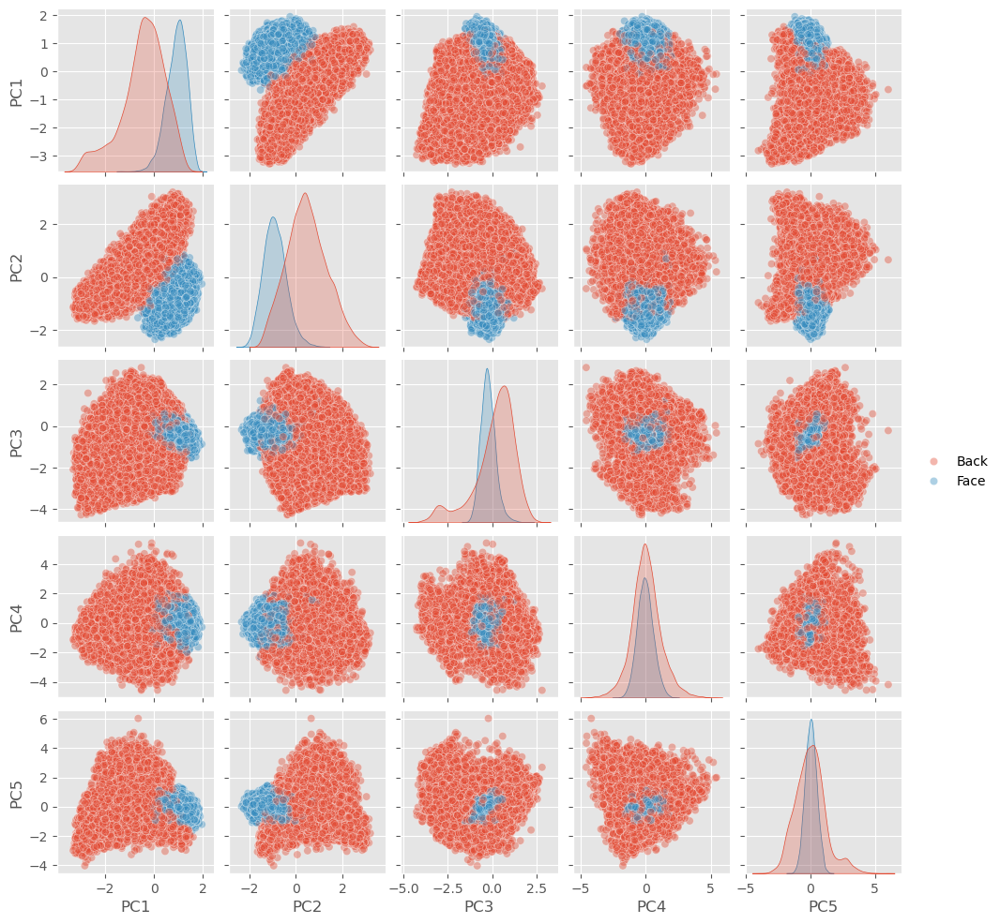


Training Classification Report:
              precision    recall  f1-score   support

           0       0.98      1.00      0.99     20549
           1       1.00      0.95      0.97     10250

    accuracy                           0.98     30799
   macro avg       0.99      0.98      0.98     30799
weighted avg       0.98      0.98      0.98     30799


Test Classification Report:
              precision    recall  f1-score   support

           0       0.98      1.00      0.99      5117
           1       1.00      0.96      0.98      2583

    accuracy                           0.99      7700
   macro avg       0.99      0.98      0.98      7700
weighted avg       0.99      0.99      0.99      7700


Experiment x2_v1_20 completed!
Explained Variance: 0.3294
Train F1: 0.9810
Test F1: 0.9834

Running experiment with n_components = 50
Suffix: x2_v1_50
Explained variance ratio: 0.4742
Tarea 2


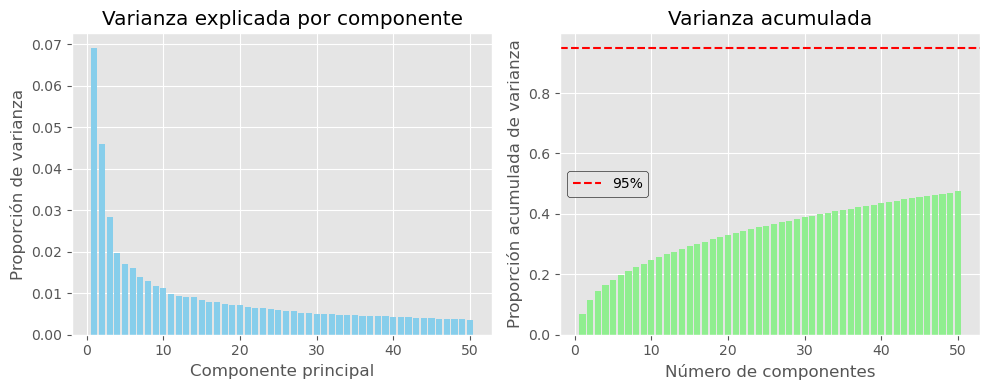

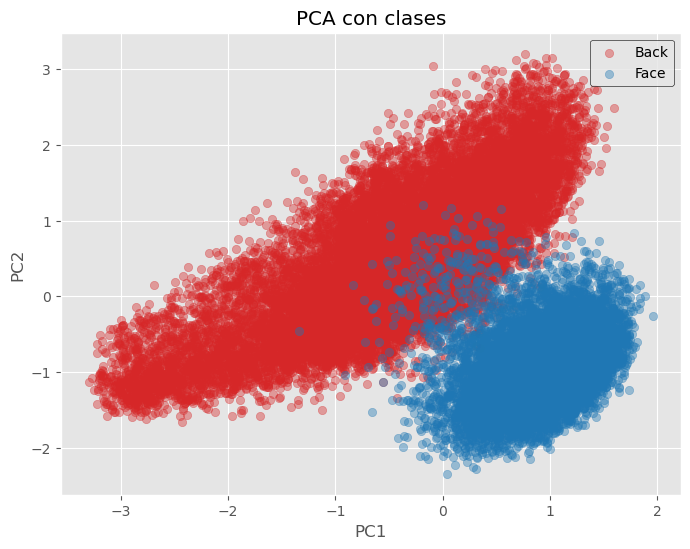

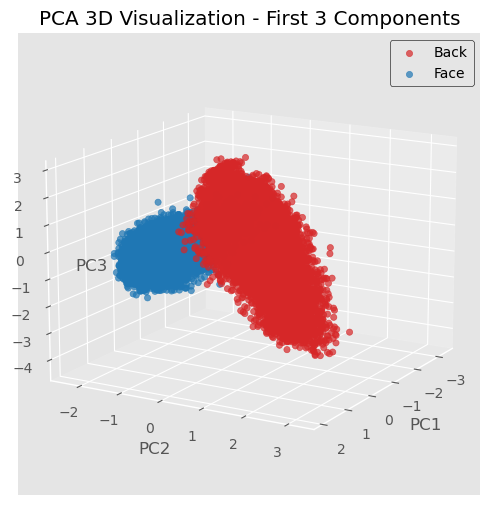

<Figure size 1200x1000 with 0 Axes>

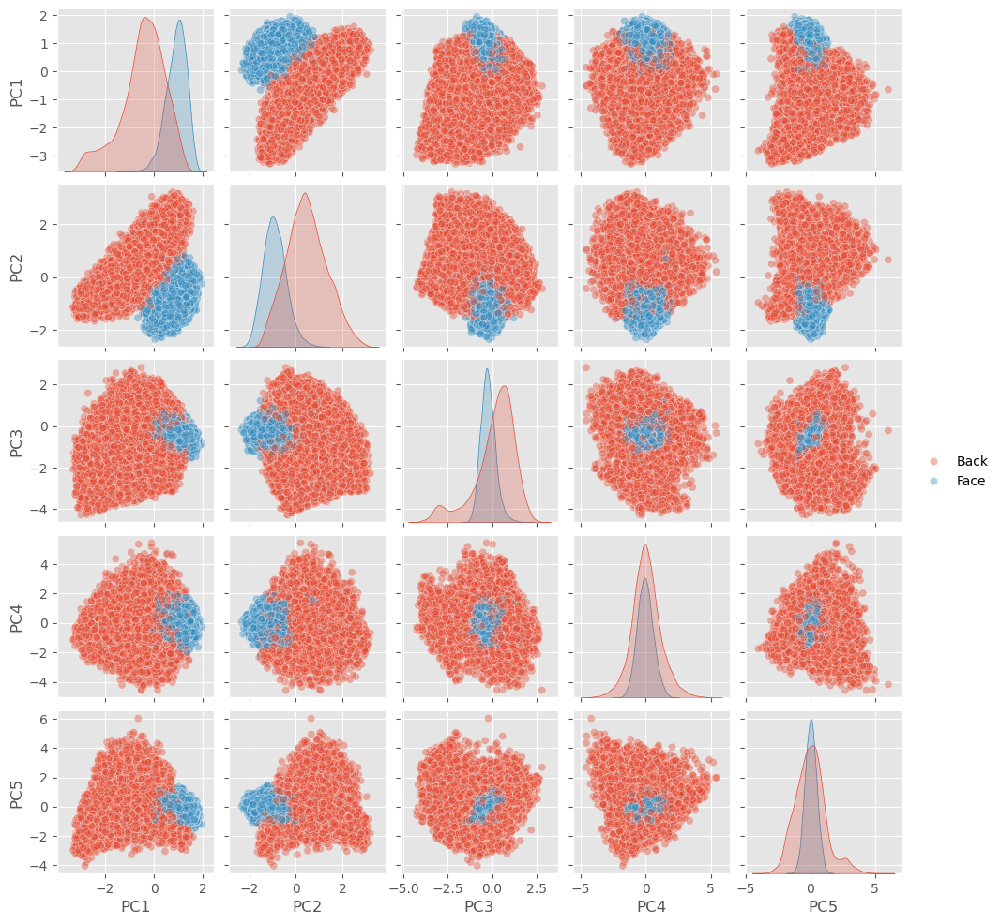


Training Classification Report:
              precision    recall  f1-score   support

           0       0.98      1.00      0.99     20549
           1       1.00      0.95      0.97     10250

    accuracy                           0.98     30799
   macro avg       0.99      0.97      0.98     30799
weighted avg       0.98      0.98      0.98     30799


Test Classification Report:
              precision    recall  f1-score   support

           0       0.98      1.00      0.99      5117
           1       1.00      0.96      0.98      2583

    accuracy                           0.99      7700
   macro avg       0.99      0.98      0.98      7700
weighted avg       0.99      0.99      0.99      7700


Experiment x2_v1_50 completed!
Explained Variance: 0.4742
Train F1: 0.9804
Test F1: 0.9840

Running experiment with n_components = 100
Suffix: x2_v1_100
Explained variance ratio: 0.6138
Tarea 2


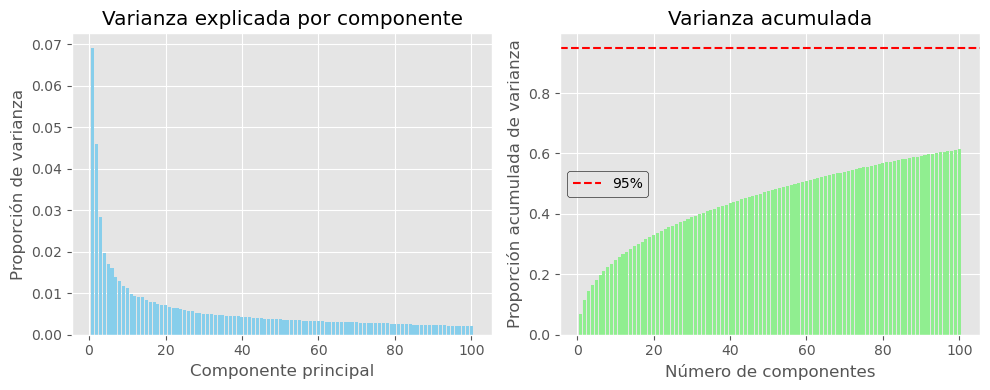

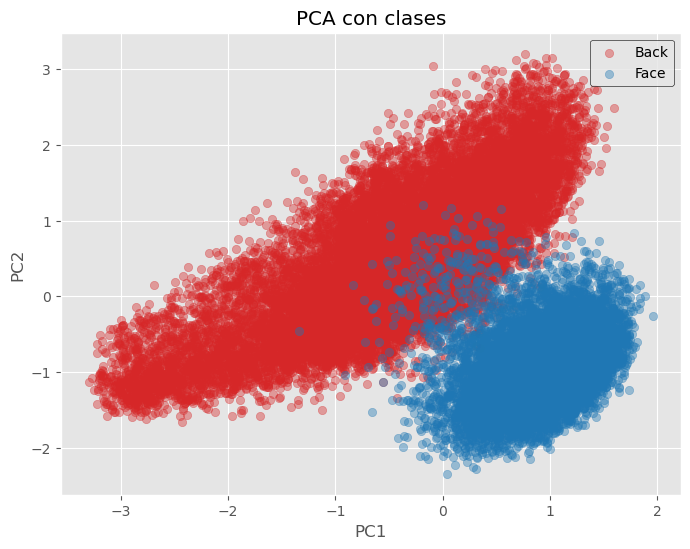

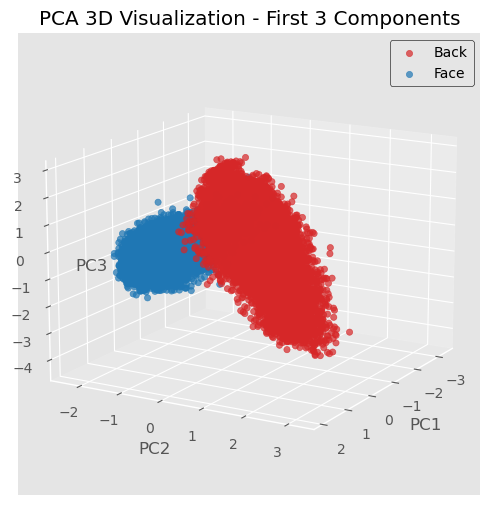

<Figure size 1200x1000 with 0 Axes>

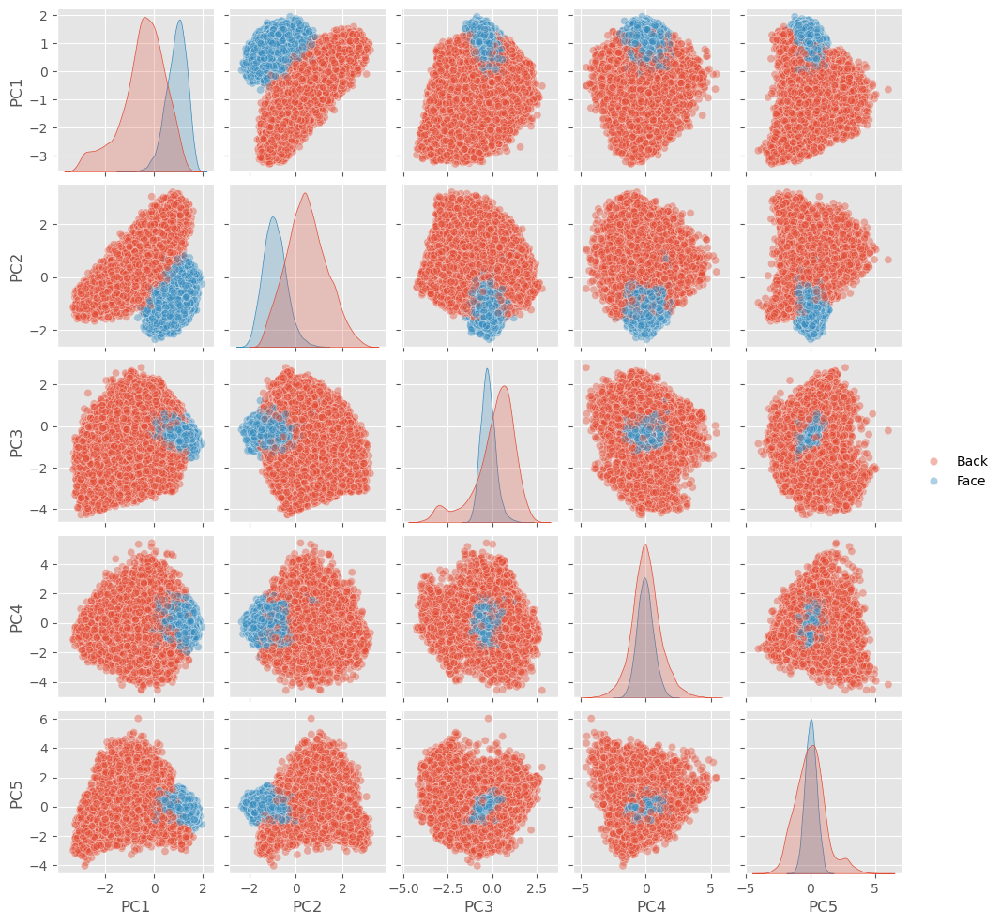


Training Classification Report:
              precision    recall  f1-score   support

           0       0.97      1.00      0.98     20549
           1       1.00      0.94      0.97     10250

    accuracy                           0.98     30799
   macro avg       0.98      0.97      0.98     30799
weighted avg       0.98      0.98      0.98     30799


Test Classification Report:
              precision    recall  f1-score   support

           0       0.98      1.00      0.99      5117
           1       1.00      0.95      0.97      2583

    accuracy                           0.98      7700
   macro avg       0.99      0.98      0.98      7700
weighted avg       0.98      0.98      0.98      7700


Experiment x2_v1_100 completed!
Explained Variance: 0.6138
Train F1: 0.9755
Test F1: 0.9811

Running experiment with n_components = 200
Suffix: x2_v1_200
Explained variance ratio: 0.7711
Tarea 2


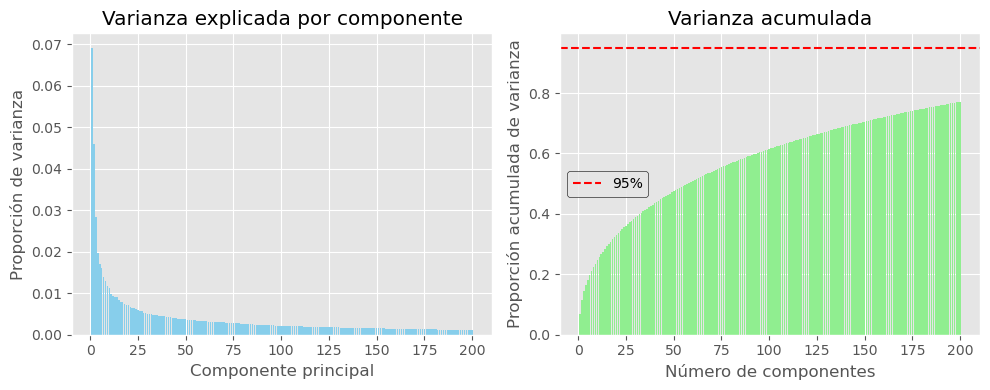

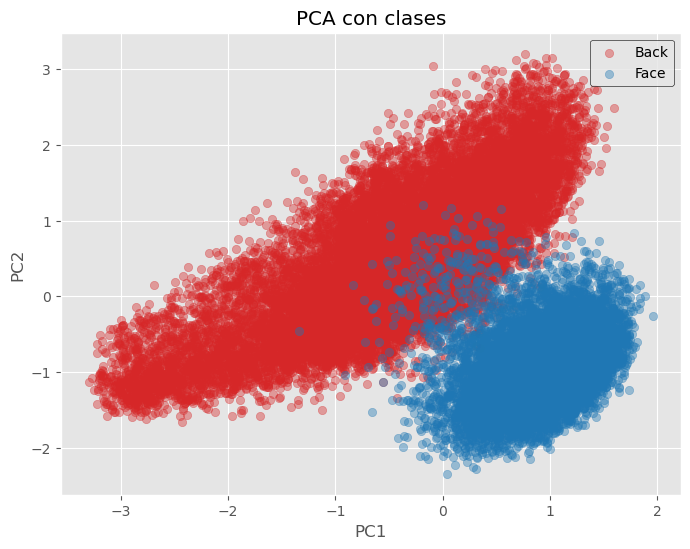

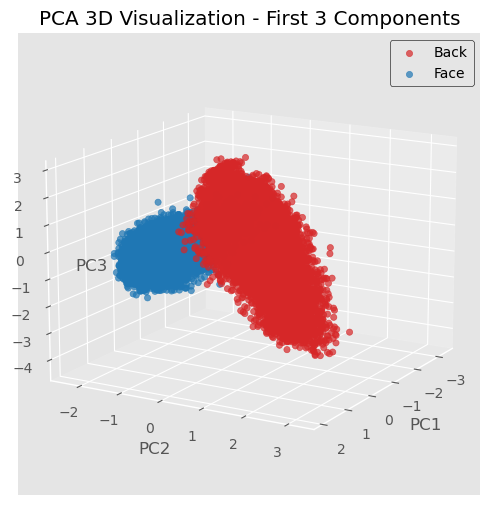

<Figure size 1200x1000 with 0 Axes>

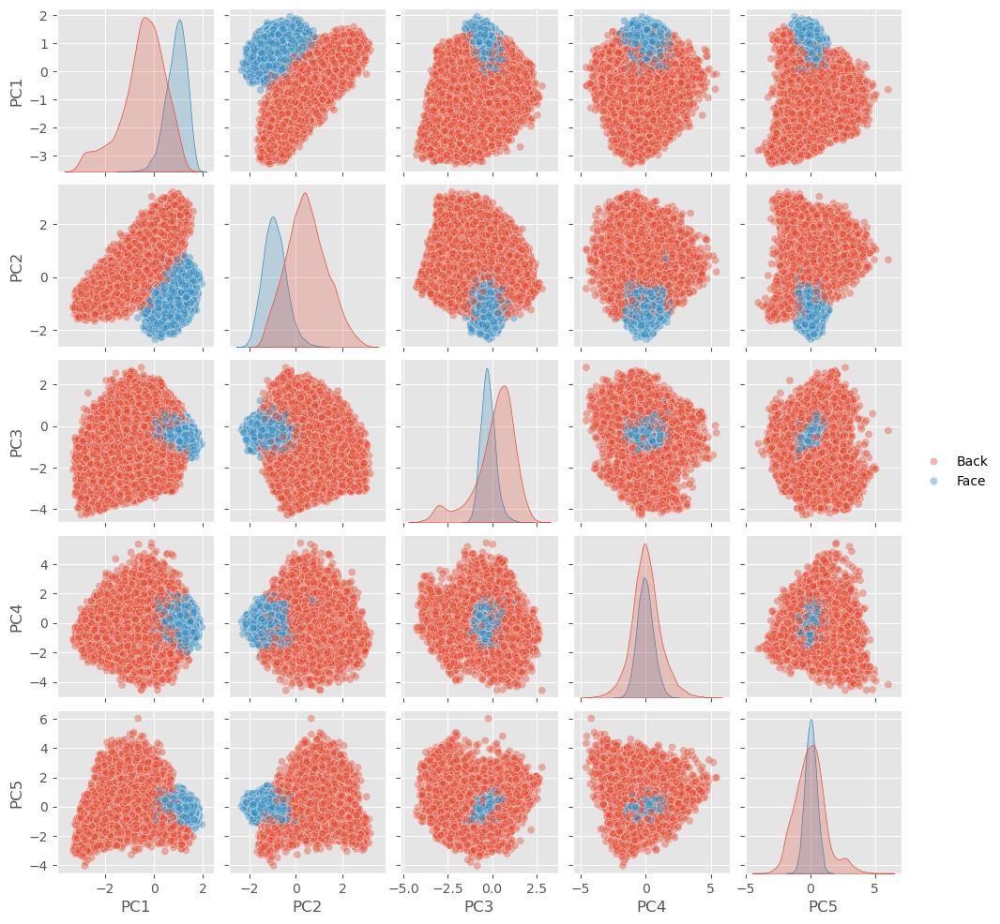


Training Classification Report:
              precision    recall  f1-score   support

           0       0.97      0.99      0.98     20549
           1       0.99      0.93      0.96     10250

    accuracy                           0.97     30799
   macro avg       0.98      0.96      0.97     30799
weighted avg       0.97      0.97      0.97     30799


Test Classification Report:
              precision    recall  f1-score   support

           0       0.97      1.00      0.98      5117
           1       0.99      0.94      0.97      2583

    accuracy                           0.98      7700
   macro avg       0.98      0.97      0.97      7700
weighted avg       0.98      0.98      0.98      7700


Experiment x2_v1_200 completed!
Explained Variance: 0.7711
Train F1: 0.9703
Test F1: 0.9746

Running experiment with n_components = 500
Suffix: x2_v1_500
Explained variance ratio: 0.9638
Tarea 2


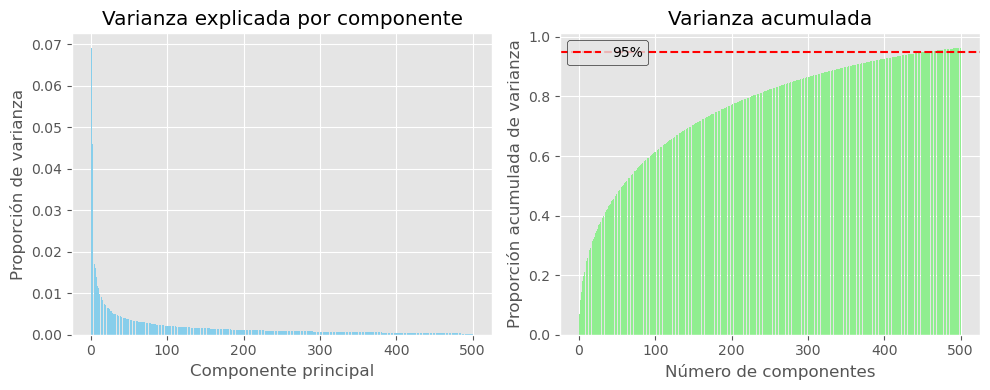

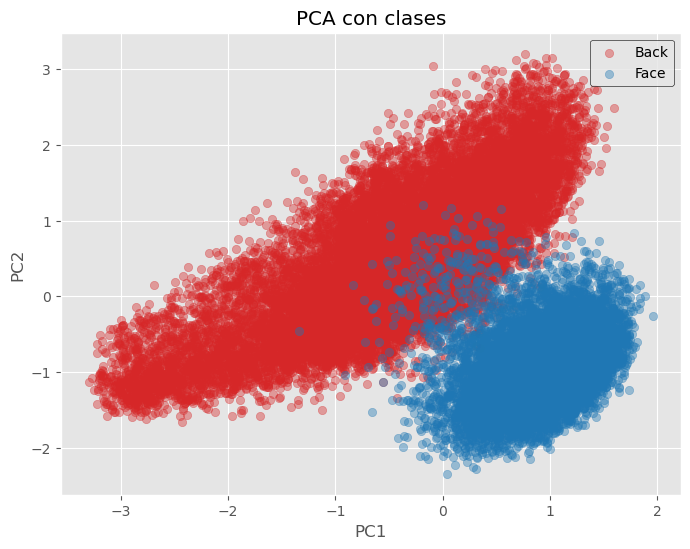

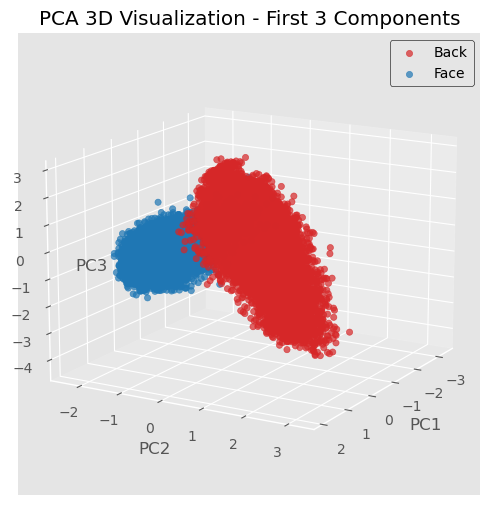

<Figure size 1200x1000 with 0 Axes>

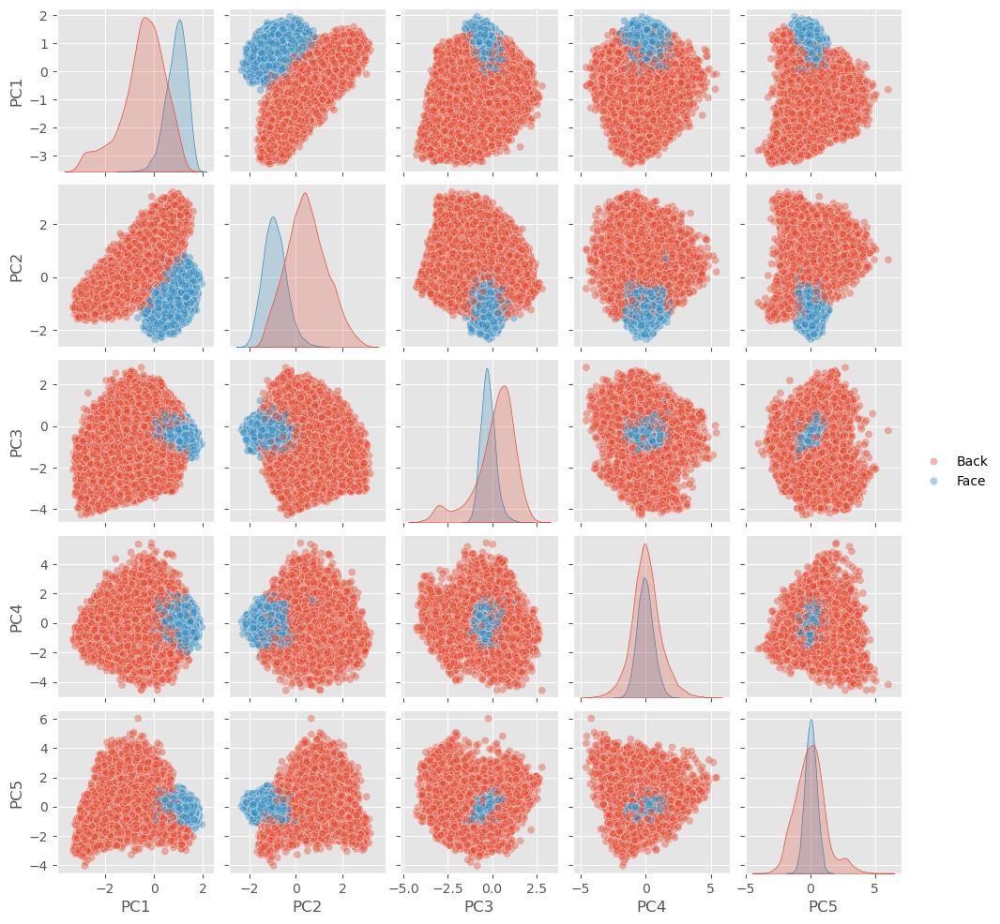


Training Classification Report:
              precision    recall  f1-score   support

           0       0.97      0.98      0.97     20549
           1       0.96      0.93      0.95     10250

    accuracy                           0.96     30799
   macro avg       0.96      0.96      0.96     30799
weighted avg       0.96      0.96      0.96     30799


Test Classification Report:
              precision    recall  f1-score   support

           0       0.96      0.98      0.97      5117
           1       0.97      0.93      0.95      2583

    accuracy                           0.96      7700
   macro avg       0.97      0.96      0.96      7700
weighted avg       0.96      0.96      0.96      7700


Experiment x2_v1_500 completed!
Explained Variance: 0.9638
Train F1: 0.9596
Test F1: 0.9603


In [ ]:
# PCA
# Define different n_components values to test
n_components_list = [20, 50, 100, 200, 500]

results = run_pca_iteration(
    X_train_std=X_train_std,
    y_train=y_train,
    X_test=X_test,
    y_test=y_test,
    scaler=scaler,
    n_components_list=n_components_list,
    ratio='x2',)

Cambios a HOG

In [21]:
hog_params = {
    'orientations': 9,
    'pixels_per_cell': (8, 8),
    'cells_per_block': (2, 2),
    'block_norm': 'L2-Hys',
    'visualize': False,
    'transform_sqrt': True,
    'feature_vector': True,
}

X = np.array([feature.hog(im, **hog_params) for im in tqdm(chain(faces, backgrounds), desc='Construyendo X')])
y = np.zeros(len(X), dtype=int)
y[:len(faces)] = 1

Construyendo X: 38499it [00:33, 1147.68it/s]


In [22]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

print(f'{ X_train.shape = }, {X_train.dtype=}, {X_train.min()=}, {X_train.max()=}')

 X_train.shape = (30799, 1764), X_train.dtype=dtype('float64'), X_train.min()=np.float64(0.0), X_train.max()=np.float64(0.9999999987499999)


In [23]:
scaler = StandardScaler()

X_train_std = scaler.fit_transform(X_train)


Running experiment with n_components = 20
Suffix: x2_v1_20
Explained variance ratio: 0.3343
Tarea 2


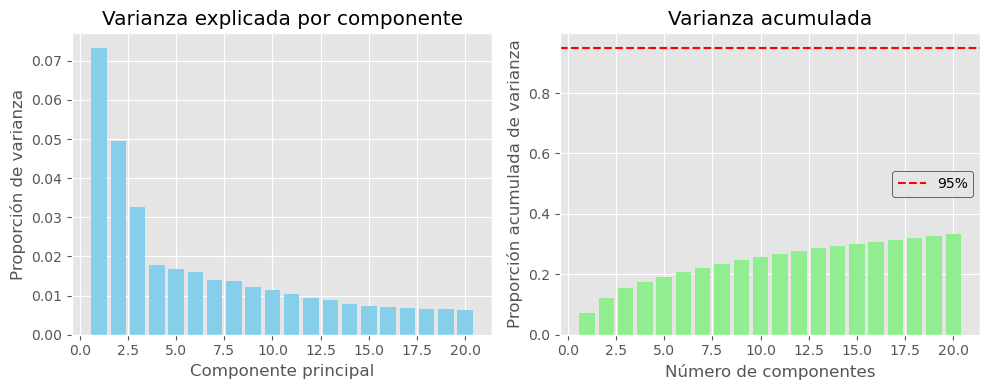

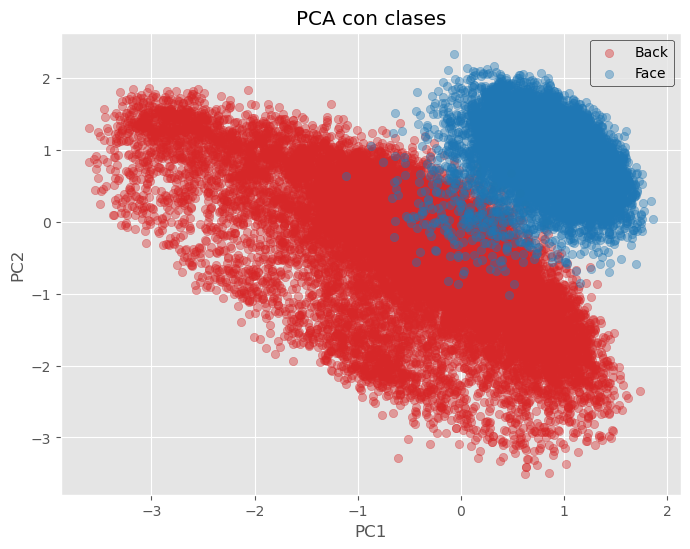

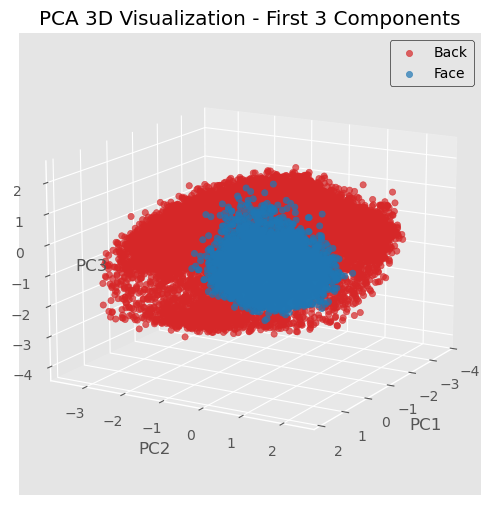

<Figure size 1200x1000 with 0 Axes>

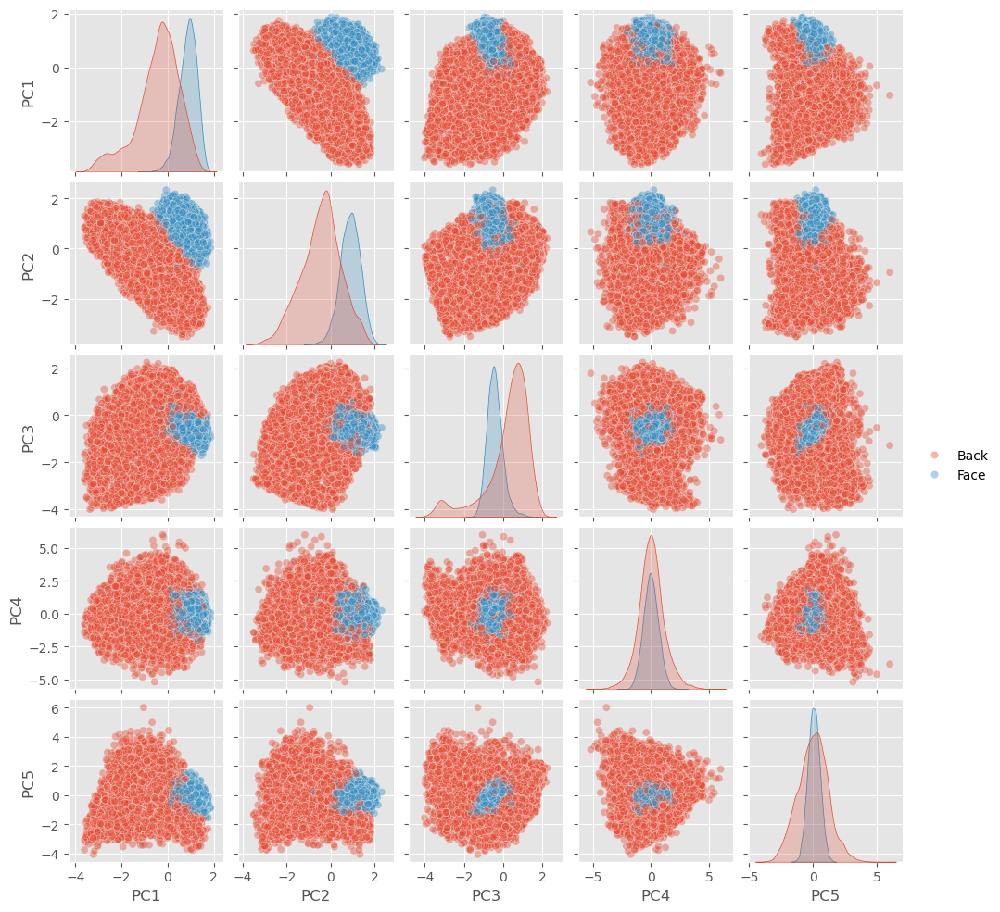


Training Classification Report:
              precision    recall  f1-score   support

           0       0.98      1.00      0.99     20549
           1       1.00      0.96      0.98     10250

    accuracy                           0.98     30799
   macro avg       0.99      0.98      0.98     30799
weighted avg       0.99      0.98      0.98     30799


Test Classification Report:
              precision    recall  f1-score   support

           0       0.98      1.00      0.99      5117
           1       1.00      0.96      0.98      2583

    accuracy                           0.99      7700
   macro avg       0.99      0.98      0.98      7700
weighted avg       0.99      0.99      0.99      7700


Experiment x2_v1_20 completed!
Explained Variance: 0.3343
Train F1: 0.9829
Test F1: 0.9846

Running experiment with n_components = 50
Suffix: x2_v1_50
Explained variance ratio: 0.4670
Tarea 2


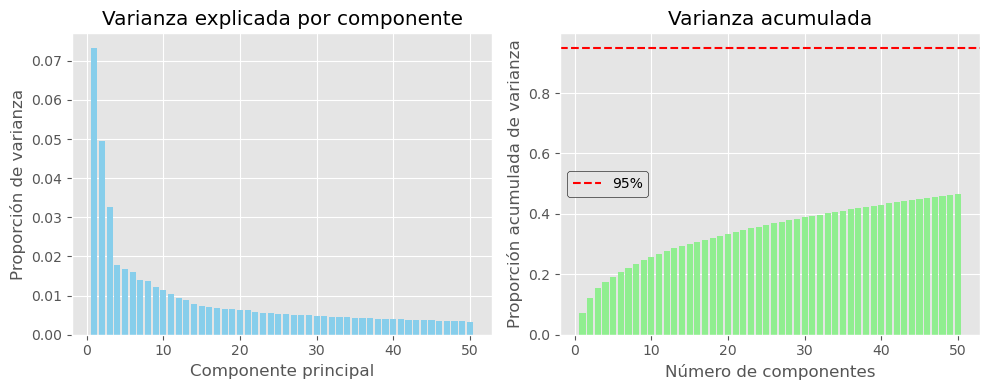

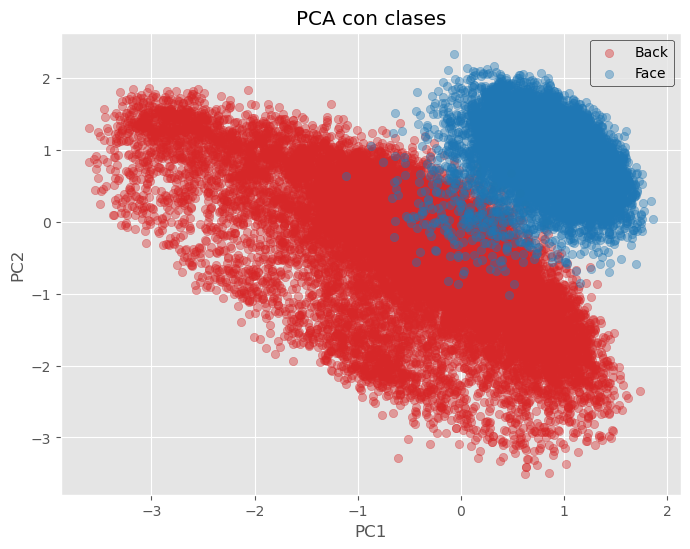

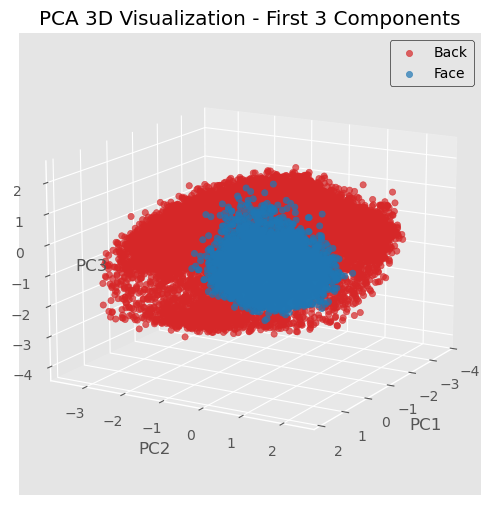

<Figure size 1200x1000 with 0 Axes>

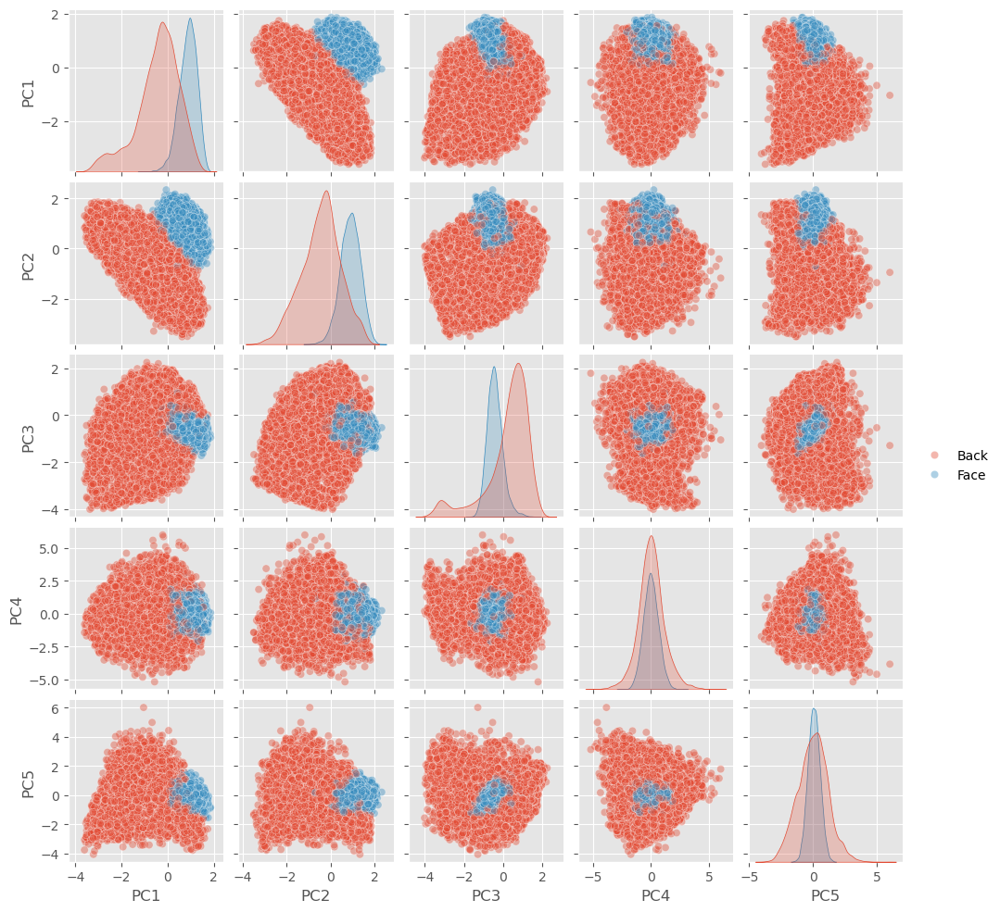


Training Classification Report:
              precision    recall  f1-score   support

           0       0.98      1.00      0.99     20549
           1       1.00      0.95      0.97     10250

    accuracy                           0.98     30799
   macro avg       0.99      0.98      0.98     30799
weighted avg       0.98      0.98      0.98     30799


Test Classification Report:
              precision    recall  f1-score   support

           0       0.98      1.00      0.99      5117
           1       1.00      0.96      0.98      2583

    accuracy                           0.99      7700
   macro avg       0.99      0.98      0.98      7700
weighted avg       0.99      0.99      0.98      7700


Experiment x2_v1_50 completed!
Explained Variance: 0.4670
Train F1: 0.9809
Test F1: 0.9831

Running experiment with n_components = 100
Suffix: x2_v1_100
Explained variance ratio: 0.5977
Tarea 2


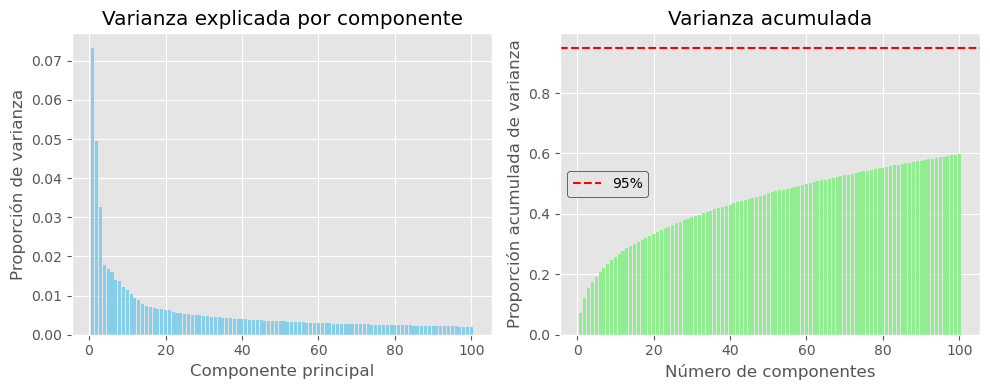

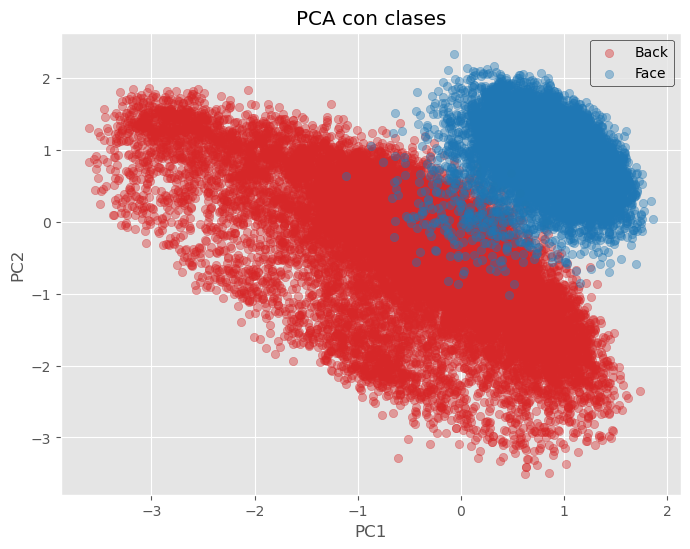

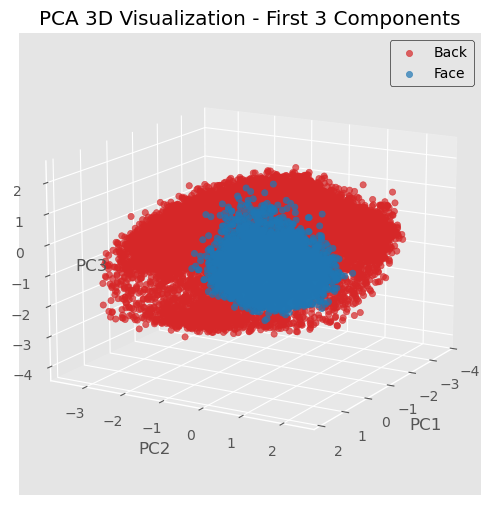

<Figure size 1200x1000 with 0 Axes>

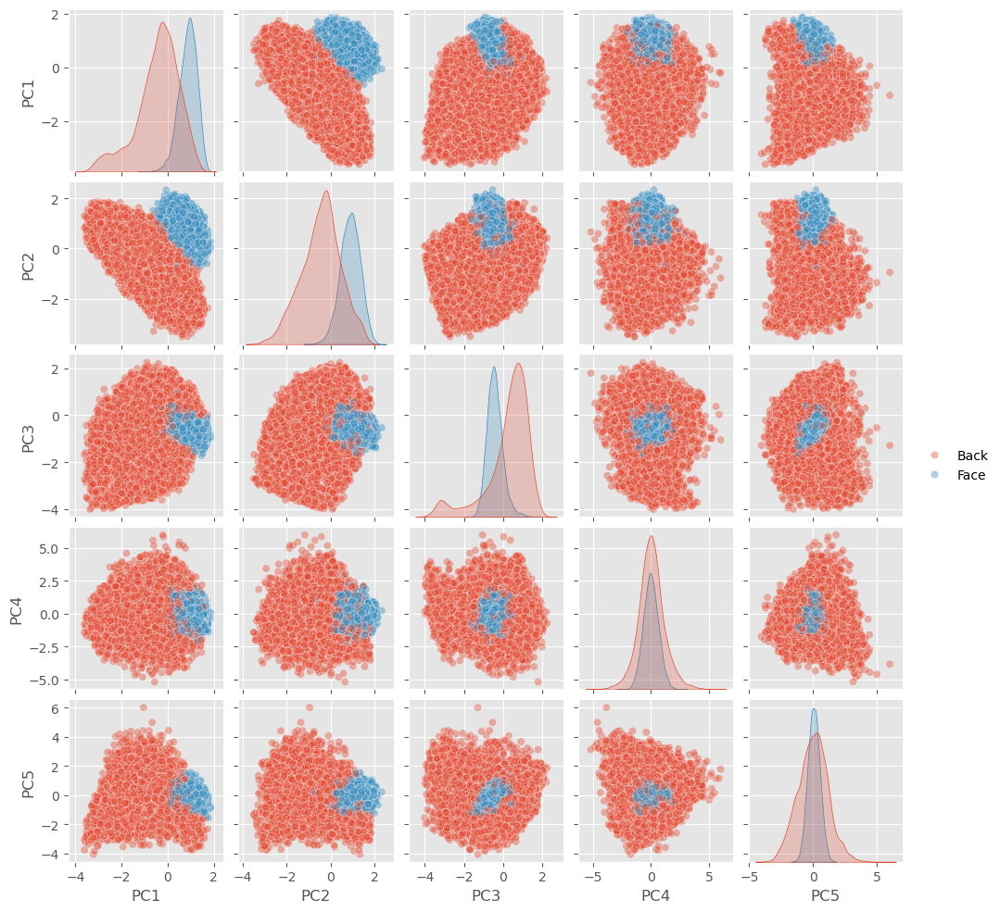


Training Classification Report:
              precision    recall  f1-score   support

           0       0.97      1.00      0.99     20549
           1       1.00      0.94      0.97     10250

    accuracy                           0.98     30799
   macro avg       0.99      0.97      0.98     30799
weighted avg       0.98      0.98      0.98     30799


Test Classification Report:
              precision    recall  f1-score   support

           0       0.98      1.00      0.99      5117
           1       1.00      0.95      0.98      2583

    accuracy                           0.98      7700
   macro avg       0.99      0.98      0.98      7700
weighted avg       0.99      0.98      0.98      7700


Experiment x2_v1_100 completed!
Explained Variance: 0.5977
Train F1: 0.9784
Test F1: 0.9826

Running experiment with n_components = 200
Suffix: x2_v1_200
Explained variance ratio: 0.7485
Tarea 2


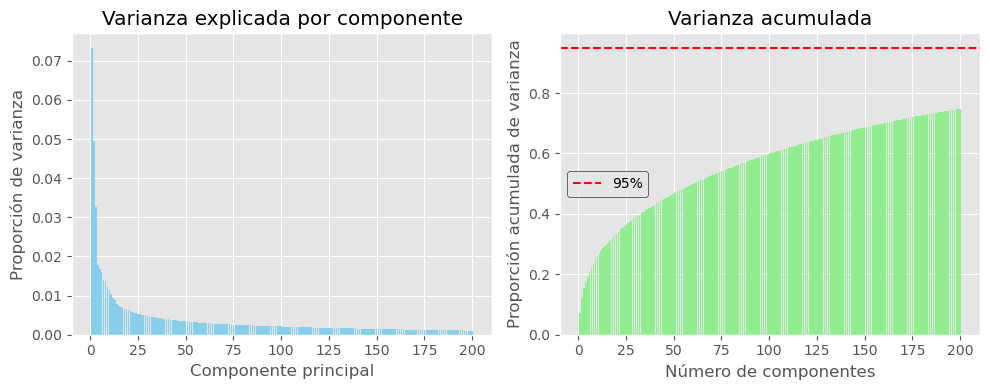

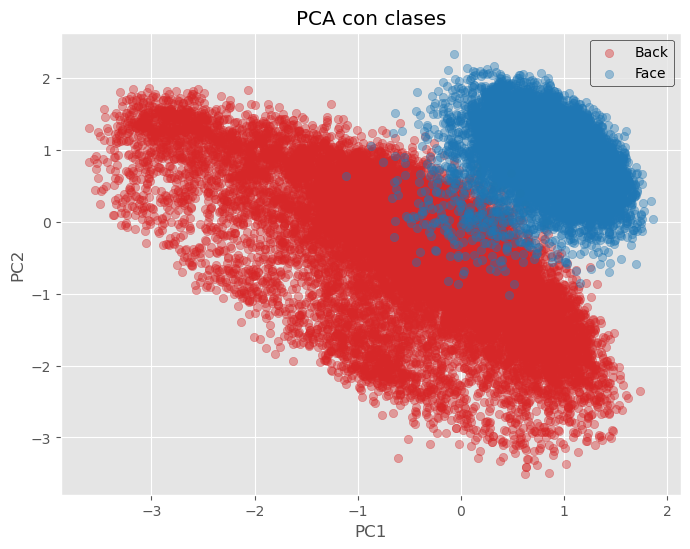

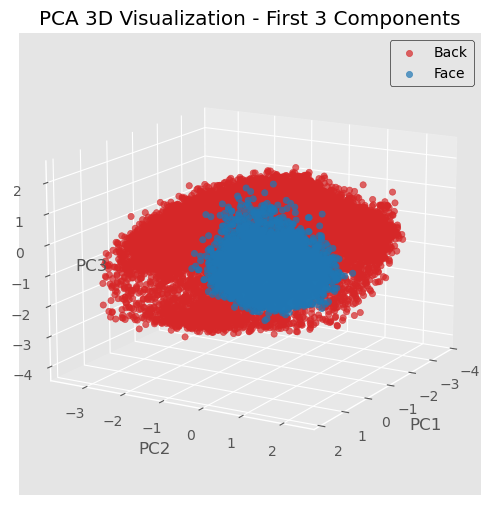

<Figure size 1200x1000 with 0 Axes>

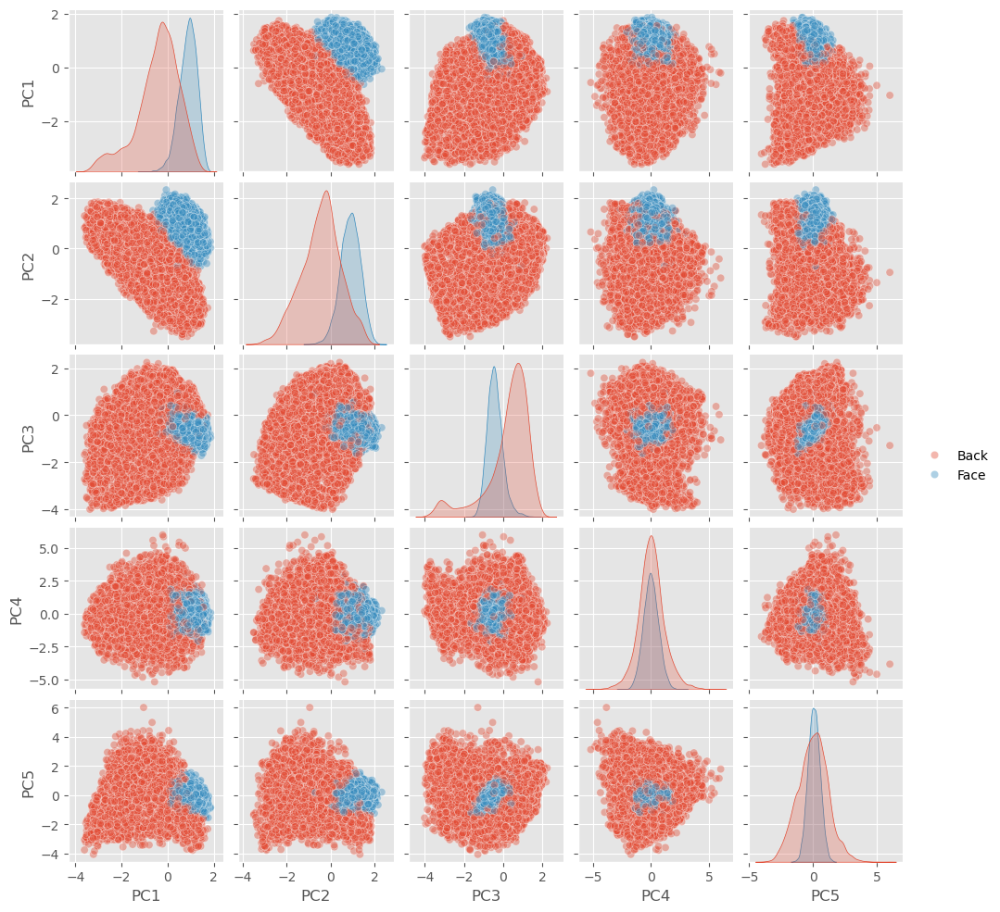


Training Classification Report:
              precision    recall  f1-score   support

           0       0.97      0.99      0.98     20549
           1       0.99      0.94      0.96     10250

    accuracy                           0.98     30799
   macro avg       0.98      0.97      0.97     30799
weighted avg       0.98      0.98      0.98     30799


Test Classification Report:
              precision    recall  f1-score   support

           0       0.98      1.00      0.99      5117
           1       0.99      0.95      0.97      2583

    accuracy                           0.98      7700
   macro avg       0.98      0.97      0.98      7700
weighted avg       0.98      0.98      0.98      7700


Experiment x2_v1_200 completed!
Explained Variance: 0.7485
Train F1: 0.9727
Test F1: 0.9779

Running experiment with n_components = 500
Suffix: x2_v1_500
Explained variance ratio: 0.9516
Tarea 2


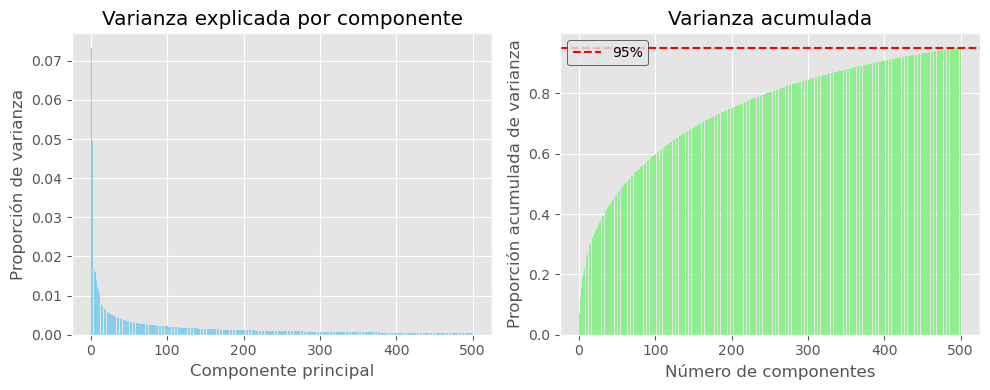

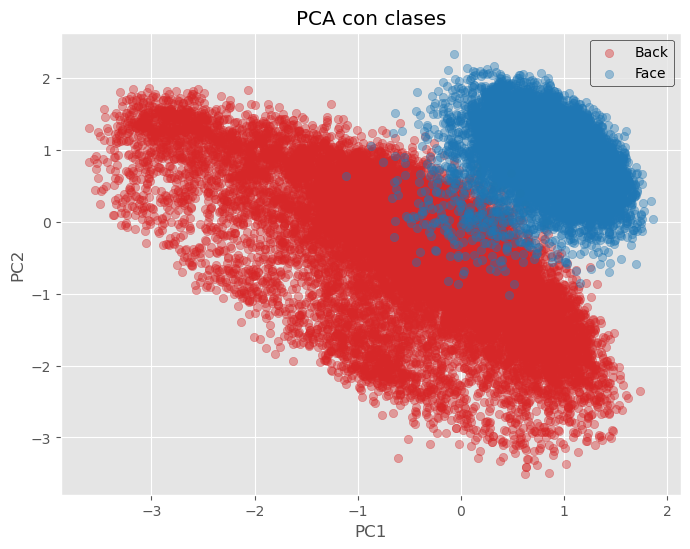

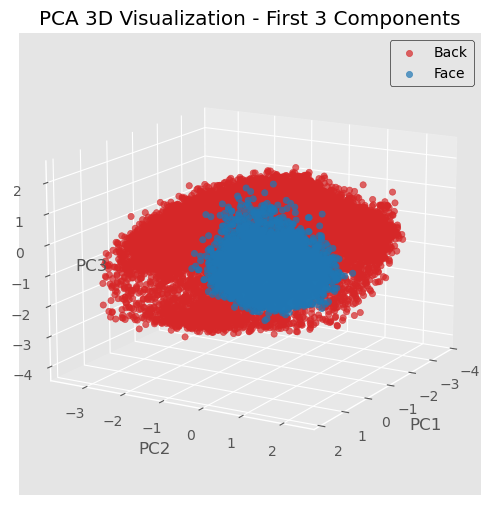

<Figure size 1200x1000 with 0 Axes>

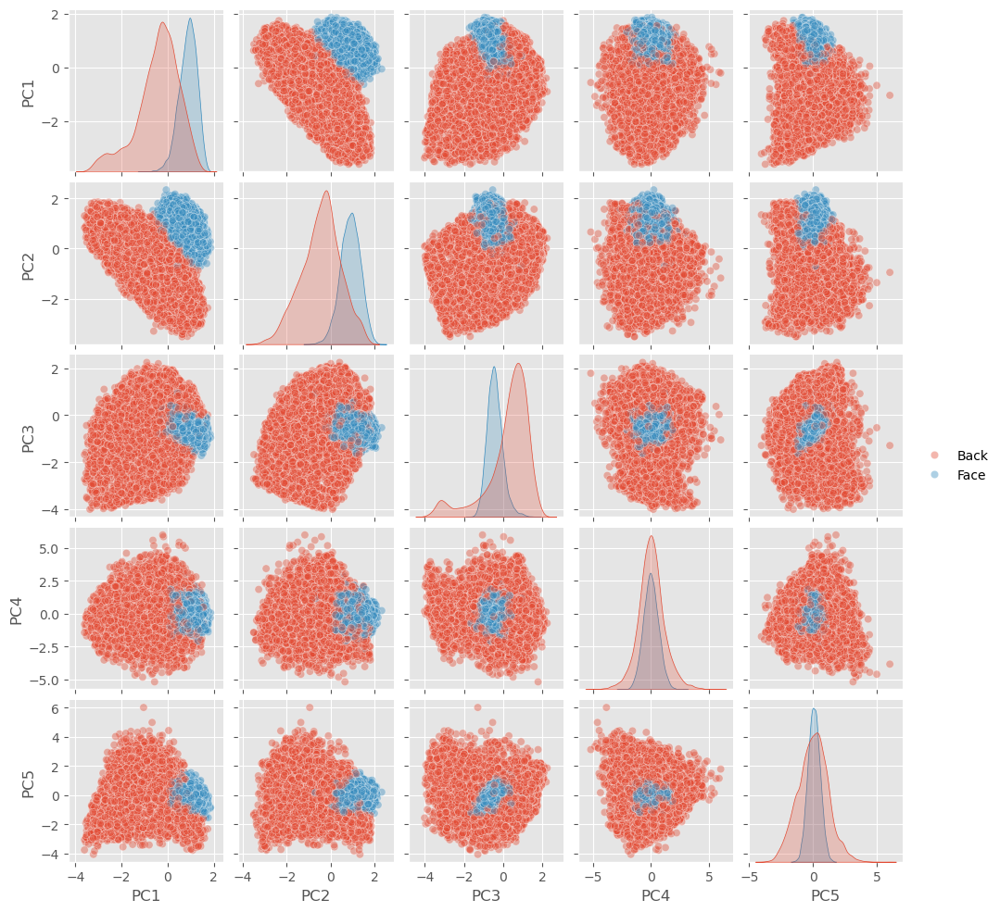


Training Classification Report:
              precision    recall  f1-score   support

           0       0.97      0.97      0.97     20549
           1       0.95      0.95      0.95     10250

    accuracy                           0.96     30799
   macro avg       0.96      0.96      0.96     30799
weighted avg       0.96      0.96      0.96     30799


Test Classification Report:
              precision    recall  f1-score   support

           0       0.97      0.97      0.97      5117
           1       0.95      0.95      0.95      2583

    accuracy                           0.96      7700
   macro avg       0.96      0.96      0.96      7700
weighted avg       0.96      0.96      0.96      7700


Experiment x2_v1_500 completed!
Explained Variance: 0.9516
Train F1: 0.9592
Test F1: 0.9601


In [ ]:
# PCA
# Define different n_components values to test
n_components_list = [20, 50, 100, 200, 500]

results = run_pca_iteration(
    X_train_std=X_train_std,
    y_train=y_train,
    X_test=X_test,
    y_test=y_test,
    scaler=scaler,
    n_components_list=n_components_list,
    ratio='x2',)